# Beta series regression

1. [To Do](#to-do) <br>
2. [fMRIprep](#fmriprep) <br>
3. [Nibetaseries](#nibetaseries) <br>
4. Age Group Differences <br>
    1. [Mean FC during cue condition](#age-group-dif-mean-fc) <br>

In [2]:
import pandas as pd
import numpy as np
import os
import glob
import matplotlib.pyplot as plt
import seaborn as sns
import nibabel as nib  # load the beta maps in python
from nilearn import plotting  # plot nifti images
from bct import nbs
from scipy.io import savemat
from mne.viz import plot_connectivity_circle


/usr/local/lib/python3.7/site-packages/nilearn/datasets/__init__.py:96: FutureWarning: Fetchers from the nilearn.datasets module will be updated in version 0.9 to return python strings instead of bytes and Pandas dataframes instead of Numpy arrays.
  "Numpy arrays.", FutureWarning)


In [30]:
data_dir = '/Volumes/psybrain/ADM/derivatives'
results_dir = '/Volumes/schnyer/Megan/adm_mem-fc/analysis/stats/'
nibs_dir='/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries'

tasks = ['MemMatch1', 'MemMatch2', 'MemMatch3']
trial_types = ['cue', 'match', 'mismatch']

atlas_file='/Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz'
atlas_lut='/Volumes/psybrain/ADM/derivatives/nibs/power264_labels.tsv'

In [31]:
subjects = np.loadtxt(data_dir + '/nibs/subjects.txt', dtype=str)
subjects

array(['30004', '30008', '30009', '30015', '30019', '30020', '30023',
       '30040', '30057', '30064', '30066', '30069', '30074', '30085',
       '30088', '30090', '30091', '30095', '30096', '30105', '30116',
       '30118', '30119', '30128', '30181', '30217', '30227', '30236',
       '30242', '30255', '30274', '30283', '30295', '30330', '30346',
       '30376', '30395', '30400', '30403', '30412', '30426', '30432',
       '30466', '30469', '30476', '30478', '30568', '30570', '30581',
       '30584', '30588', '40160', '40170', '40175', '40288', '40351',
       '40490', '40512', '40519', '40520', '40524', '40547', '40564',
       '40615', '40619', '40624', '40638', '40649', '40650', '40656',
       '40658', '40664', '40665', '40668', '40672', '40685', '40694',
       '40720', '40738', '40743', '40750', '40773', '40778', '40796',
       '40803', '40855', '40861', '40930', '40961', '40968'], dtype='<U5')

In [32]:
atlas = pd.read_csv(atlas_lut, sep='\t').set_index('index')

atlas.regions.unique()

array(['Uncertain', 'Sensory/somatomotor Hand',
       'Sensory/somatomotor Mouth', 'Cingulo-opercular Task Control',
       'Auditory', 'Default mode', 'Memory retrieval?',
       'Ventral attention', 'Visual', 'Fronto-parietal Task Control',
       'Salience', 'Subcortical', 'Cerebellar', 'Dorsal attention'],
      dtype=object)

In [33]:
atlas.columns

Index(['regions'], dtype='object')

In [34]:
atlas = pd.read_csv(atlas_lut, sep='\t').set_index('index')

dmn = atlas.loc[atlas['regions'].str.contains('Default')].index.tolist()
fpn = atlas.loc[atlas['regions'].str.contains('Fronto-parietal')].index.tolist()
dmn_fpn = np.concatenate((dmn, fpn))


In [35]:
from nilearn import datasets

power = datasets.fetch_coords_power_2011()
coords = np.vstack((power.rois['x'], power.rois['y'], power.rois['z'])).T


## To Do <a id='to-do'></a>

1. Finish running fmriprep. Repeat for MemMatch 2, 3

9/30: Participants currently running on TACC: \
40961 40968 30255 40861 40855 40782 40496 30417 30090

10/2: Participants complete: 
40961(y) 40968(y) 30255(y) 40861(y) 40855(y) 40782(y) 40496(y) 30417(y) 30090(y)

still need fmriprep on
**30417** - no MemMatch (drop) \
**40782** - run 1: 	 nibs crashfile: /Volumes/psybrain/ADM/derivatives/nibs/sub-40782/log/crash-20211010-115537-PSYC-mcm5324-betaseries_node.a0-de5d651f-0cca-4483-9b22-4fe6ed206768.txt, only has 8 trials for some reason, not 12
**40930** \

3. Run nibetaseries

Confound selection: \
https://neurostars.org/t/confounds-from-fmriprep-which-one-would-you-use-for-glm/326 \
https://code.stanford.edu/rblair2/fmriprep-test/-/blob/master/docs/outputs.rst \


**Participants missing BIDS**
40496 - MemMatch1 \
30433? \
30407 - anat only \
40876

# fMRIprep <a id='fmriprep'></a>

```

Results included in this manuscript come from preprocessing
performed using *fMRIPrep* 1.3.2
(@fmriprep1; @fmriprep2; RRID:SCR_016216),
which is based on *Nipype* 1.1.9
(@nipype1; @nipype2; RRID:SCR_002502).

Anatomical data preprocessing

: The T1-weighted (T1w) image was corrected for intensity non-uniformity (INU)
with `N4BiasFieldCorrection` [@n4], distributed with ANTs 2.2.0 [@ants, RRID:SCR_004757], and used as T1w-reference throughout the workflow.
The T1w-reference was then skull-stripped with a *Nipype* implementation of
the `antsBrainExtraction.sh` workflow (from ANTs), using OASIS30ANTs
as target template.
Spatial normalization to the
*ICBM 152 Nonlinear Asymmetrical template version 2009c* [@mni152nlin2009casym, RRID:SCR_008796]
was performed through nonlinear registration with `antsRegistration`
(ANTs 2.2.0), using brain-extracted versions of both T1w volume
and template.
Brain tissue segmentation of cerebrospinal fluid (CSF),
white-matter (WM) and gray-matter (GM) was performed on
the brain-extracted T1w using `fast` [FSL 5.0.9, RRID:SCR_002823,
@fsl_fast].


Functional data preprocessing

: For each of the 1 BOLD runs found per subject (across all
tasks and sessions), the following preprocessing was performed.
First, a reference volume and its skull-stripped version were generated
using a custom methodology of *fMRIPrep*.
The BOLD reference was then co-registered to the T1w reference using
`flirt` [FSL 5.0.9, @flirt] with the boundary-based registration [@bbr]
cost-function.
Co-registration was configured with nine degrees of freedom to account
for distortions remaining in the BOLD reference.
Head-motion parameters with respect to the BOLD reference
(transformation matrices, and six corresponding rotation and translation
parameters) are estimated before any spatiotemporal filtering using
`mcflirt` [FSL 5.0.9, @mcflirt].
The BOLD time-series (including slice-timing correction when applied)
were resampled onto their original, native space by applying
a single, composite transform to correct for head-motion and
susceptibility distortions.
These resampled BOLD time-series will be referred to as *preprocessed
BOLD in original space*, or just *preprocessed BOLD*.
The BOLD time-series were resampled to MNI152NLin2009cAsym standard space,
generating a *preprocessed BOLD run in MNI152NLin2009cAsym space*.
First, a reference volume and its skull-stripped version were generated
using a custom methodology of *fMRIPrep*.
Several confounding time-series were calculated based on the
*preprocessed BOLD*: framewise displacement (FD), DVARS and
three region-wise global signals.
FD and DVARS are calculated for each functional run, both using their
implementations in *Nipype* [following the definitions by @power_fd_dvars].
The three global signals are extracted within the CSF, the WM, and
the whole-brain masks.
Additionally, a set of physiological regressors were extracted to
allow for component-based noise correction [*CompCor*, @compcor].
Principal components are estimated after high-pass filtering the
*preprocessed BOLD* time-series (using a discrete cosine filter with
128s cut-off) for the two *CompCor* variants: temporal (tCompCor)
and anatomical (aCompCor).
Six tCompCor components are then calculated from the top 5% variable
voxels within a mask covering the subcortical regions.
This subcortical mask is obtained by heavily eroding the brain mask,
which ensures it does not include cortical GM regions.
For aCompCor, six components are calculated within the intersection of
the aforementioned mask and the union of CSF and WM masks calculated
in T1w space, after their projection to the native space of each
functional run (using the inverse BOLD-to-T1w transformation).
The head-motion estimates calculated in the correction step were also
placed within the corresponding confounds file.
All resamplings can be performed with *a single interpolation
step* by composing all the pertinent transformations (i.e. head-motion
transform matrices, susceptibility distortion correction when available,
and co-registrations to anatomical and template spaces).
Gridded (volumetric) resamplings were performed using `antsApplyTransforms` (ANTs),
configured with Lanczos interpolation to minimize the smoothing
effects of other kernels [@lanczos].
Non-gridded (surface) resamplings were performed using `mri_vol2surf`
(FreeSurfer).


Many internal operations of *fMRIPrep* use
*Nilearn* 0.5.0 [@nilearn, RRID:SCR_001362],
mostly within the functional processing workflow.
For more details of the pipeline, see [the section corresponding
to workflows in *fMRIPrep*'s documentation](https://fmriprep.readthedocs.io/en/latest/workflows.html "FMRIPrep's documentation").

```

In [81]:
confounds.drop(['bad_tr', 'ones', 'zeros'], axis=1)

,csf,white_matter,global_signal,std_dvars,dvars,framewise_displacement,t_comp_cor_00,t_comp_cor_01,t_comp_cor_02,t_comp_cor_03,...,cosine00,cosine01,trans_x,trans_y,trans_z,rot_x,rot_y,rot_z,ones,zeros
0,8132.941465,8430.043355,10624.859048,NaN,NaN,NaN,-0.079709,-0.056285,0.046953,-0.103024,...,0.110426,0.110411,4.920140e-03,0.038473,0.005280,0.001138,0.000214,0.000000e+00,1.0,0.0
1,8118.993240,8423.914560,10577.636159,1.051489,40.897327,0.084527,0.089475,-0.065596,0.010070,0.041240,...,0.110386,0.110249,2.303580e-05,0.069225,0.013104,0.000687,-0.000155,0.000000e+00,1.0,0.0
2,8020.358740,8430.049396,10571.339513,1.084961,42.199207,0.130803,-0.071840,0.040449,0.170075,-0.088761,...,0.110305,0.109925,4.679570e-03,-0.011595,0.016988,0.001102,0.000126,1.322220e-04,1.0,0.0
3,8058.544199,8430.659345,10576.353999,1.071283,41.667221,0.152826,-0.002172,-0.080552,-0.030993,0.100144,...,0.110183,0.109440,5.333430e-03,0.057416,0.023376,-0.000076,0.000413,2.034870e-04,1.0,0.0
4,8099.276890,8420.325988,10595.796510,1.098948,42.743244,0.189638,0.039654,0.121412,-0.061580,-0.032889,...,0.110021,0.108794,3.623230e-03,-0.007185,-0.005324,0.001216,0.000015,0.000000e+00,1.0,0.0
5,8079.179951,8425.925489,10594.284375,1.061801,41.298401,0.135861,-0.047149,-0.066098,-0.148289,0.034201,...,0.109819,0.107989,5.139560e-03,0.063385,-0.012187,0.000242,0.000019,1.608700e-04,1.0,0.0
6,8121.391640,8435.339866,10615.311500,1.063446,41.362389,0.130187,0.032311,0.133752,-0.189352,-0.022093,...,0.109577,0.107025,3.377740e-03,-0.018775,-0.021933,0.000669,0.000260,9.789380e-05,1.0,0.0
7,8118.548607,8434.347107,10607.950571,1.088768,42.347290,0.113821,-0.061810,-0.078515,-0.119782,-0.056126,...,0.109294,0.105904,5.044140e-03,0.053001,-0.021891,0.000163,0.000057,0.000000e+00,1.0,0.0
8,8107.806210,8424.609646,10596.410278,1.052938,40.953690,0.112026,0.089237,0.042260,-0.023750,-0.011819,...,0.108971,0.104627,2.552580e-05,-0.005808,-0.021897,0.000984,-0.000085,0.000000e+00,1.0,0.0
9,8082.584959,8431.336269,10602.852501,1.067278,41.511429,0.098979,-0.077187,-0.075407,-0.054886,-0.113926,...,0.108608,0.103197,2.272360e-05,0.072470,-0.030436,0.000850,0.000024,0.000000e+00,1.0,0.0


```for subject in subjects:
    for task in tasks:
        confounds_file = data_dir + '/fmriprep/sub-%s/func/sub-%s_task-%s_run-01_desc-confounds_regressors.tsv' % (subject, subject, task)
        print(confounds_file)
        
        confounds = pd.read_csv(confounds_file, sep = '\t')
        for colname in ['bad_tr', 'ones', 'zeros', 'motion_outlier_01']:
            if colname in confounds.columns:
                confounds.drop(colname, axis=1, inplace=True)
        if not os.path.exists(confounds_file.split('.tsv')[0] + '_original.tsv'):
            confounds.to_csv(confounds_file.split('.tsv')[0] + '_original.tsv', index=False, sep = '\t')

        confounds['motion_outlier_00'] = np.where(confounds['framewise_displacement'] >= 0.5, 1, 0)
#         confounds['motion_outlier_01'] = np.ones(len(confounds['framewise_displacement']), dtype=int)
        confounds.to_csv(confounds_file, index=False, sep = '\t')
        
        print(confounds.loc[confounds['motion_outlier_00'] > 0.5])
        
```

In [3]:
events_files = glob.glob('/Volumes/psybrain/ADM/sub-40782/func/*events.tsv')
print(events_files)


['/Volumes/psybrain/ADM/sub-40782/func/sub-40782_task-MemMatch3_run-01_events.tsv', '/Volumes/psybrain/ADM/sub-40782/func/sub-40782_task-MemRepeat3_run-01_events.tsv', '/Volumes/psybrain/ADM/sub-40782/func/sub-40782_task-MemRepeat1_run-01_events.tsv', '/Volumes/psybrain/ADM/sub-40782/func/sub-40782_task-MemMatch2_run-01_events.tsv', '/Volumes/psybrain/ADM/sub-40782/func/sub-40782_task-MemMatch1_run-01_events.tsv', '/Volumes/psybrain/ADM/sub-40782/func/sub-40782_task-MemRepeat2_run-01_events.tsv']


# Nibetaseries <a id='nibetaseries'></a>

```bash

cd /Volumes/psybrain/ADM/derivatives/nibs/
rm -rf nibetaseries_work/.smb*

for subject in `cat remaining.txt | tail -10`; do
    echo $subject
    printf '\n\n RUN 1'
    nibs --nthreads 1 -n-cpus 1 -c a_comp_cor_00 trans_x trans_y trans_z rot_x rot_y rot_z motion_outlier_00 -t MemMatch1 --participant-label $subject --estimator lss --hrf-model 'spm + derivative' -sm 6 /Volumes/psybrain/ADM /Volumes/psybrain/ADM/derivatives/fmriprep /Volumes/psybrain/ADM/derivatives/nibs participant; sleep 10;
    printf '\n\n RUN 2'
    nibs --nthreads 1 -n-cpus 1 -c a_comp_cor_00 trans_x trans_y trans_z rot_x rot_y rot_z motion_outlier_00 -t MemMatch2 --participant-label $subject --estimator lss --hrf-model 'spm + derivative' -sm 6 /Volumes/psybrain/ADM /Volumes/psybrain/ADM/derivatives/fmriprep /Volumes/psybrain/ADM/derivatives/nibs participant; sleep 10;
    printf '\n\n RUN 3'
    nibs --nthreads 1 -n-cpus 1 -c a_comp_cor_00 trans_x trans_y trans_z rot_x rot_y rot_z motion_outlier_00 -t MemMatch3 --participant-label $subject --estimator lss --hrf-model 'spm + derivative' -sm 6 /Volumes/psybrain/ADM /Volumes/psybrain/ADM/derivatives/fmriprep /Volumes/psybrain/ADM/derivatives/nibs participant; sleep 10;
    echo "completed subjects: " 
    echo `ls nibetaseries/. | wc -l`
done




## Checking which subjects still need nibs

In [8]:
remaining = []

for subject in subjects:
    if 'sub-' + subject not in os.listdir(nibs_dir):
        remaining.append(subject)

print('subjects remaining %.f' % len(remaining))
np.savetxt('/Volumes/psybrain/ADM/derivatives/nibs/subjects_remaining.txt', remaining, fmt = "%s")

subjects remaining 40


In [15]:
subject = '30004'
check_file = nibs_dir + '/%s/func/%s_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz' % (subject, subject)
print(check_file)
glob.glob(check_file)

/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/30004/func/30004_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz


[]

In [45]:
sub_run1 = []
sub_run2 = []
sub_run3 = []

for subject in np.loadtxt('/Volumes/psybrain/ADM/derivatives/nibs/subjects.txt', dtype=str):
    print(subject)
    check_file = nibs_dir + '/sub-%s/func/sub-%s_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz' % (subject, subject)
    print(check_file)
    completed = glob.glob(check_file)
    nrun = len(completed)
    missing = []
    
    if nrun < 3:
        for file in completed:
            print(file)
            print(file.split('MemMatch')[1][:1])
            missing.append(file.split('MemMatch')[1][:1])
            print(missing)
            
        if '1' not in missing:
            print('missing 1')
            sub_run1.append(subject)
            
        if '2' not in missing:
            print('missing 2')
            sub_run2.append(subject)
            
        if '3' not in missing:
            print('missing 3')
            sub_run3.append(subject)
    

30004
/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-30004/func/sub-30004_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
30008
/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-30008/func/sub-30008_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
30009
/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-30009/func/sub-30009_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
30015
/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-30015/func/sub-30015_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
30019
/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-30019/func/sub-30019_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
30020
/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-30020/func/sub-30020_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
30023
/Volumes/psybrain/ADM/deriva

40520
/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40520/func/sub-40520_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
40524
/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40524/func/sub-40524_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
40547
/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40547/func/sub-40547_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
40564
/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40564/func/sub-40564_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
40615
/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40615/func/sub-40615_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
40619
/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40619/func/sub-40619_task-MemMatch[1-3]_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
40624
/Volumes/psybrain/ADM/deriva

In [46]:
print('remaining subjects without MemMatch1 beta images: n =%.f' % len(sub_run1))
print('remaining subjects without MemMatch2 beta images: n =%.f' % len(sub_run2))
print('remaining subjects without MemMatch3 beta images: n =%.f' % len(sub_run3))

remaining subjects without MemMatch1 beta images: n =1
remaining subjects without MemMatch2 beta images: n =1
remaining subjects without MemMatch3 beta images: n =1


In [26]:
np.savetxt('/Volumes/psybrain/ADM/derivatives/nibs/subjects_run1.txt', sub_run1, fmt = "%s")

In [27]:
np.savetxt('/Volumes/psybrain/ADM/derivatives/nibs/subjects_run2.txt', sub_run2, fmt = "%s")

In [28]:
np.savetxt('/Volumes/psybrain/ADM/derivatives/nibs/subjects_run3.txt', sub_run3, fmt = "%s")

In [ ]:
```bash
cd /Volumes/psybrain/ADM/derivatives/nibs/
rm -rf nibetaseries_work/.smb*

# nibs -c a_comp_cor_00 trans_x trans_y trans_z rot_x rot_y rot_z motion_outlier_00 -t MemMatch1 --participant-label `cat subjects_run1.txt | head -8` --estimator lss --hrf-model 'spm + derivative' -sm 6 /Volumes/psybrain/ADM /Volumes/psybrain/ADM/derivatives/fmriprep /Volumes/psybrain/ADM/derivatives/nibs participant
nibs -c a_comp_cor_00 trans_x trans_y trans_z rot_x rot_y rot_z motion_outlier_00 -t MemMatch1 --participant-label sub-40930 sub-40930 --estimator lss --hrf-model 'spm + derivative' -sm 6 /Volumes/psybrain/ADM /Volumes/psybrain/ADM/derivatives/fmriprep /Volumes/psybrain/ADM/derivatives/nibs participant


```

## Correlation results

In [64]:
event_files = glob.glob('/Volumes/psybrain/ADM/sub-*/func/*MemMatch1*[0-9]_events.tsv')
event_files

['/Volumes/psybrain/ADM/sub-40608/func/sub-40608_task-MemMatch1_run-01_events.tsv',
 '/Volumes/psybrain/ADM/sub-40649/func/sub-40649_task-MemMatch1_run-01_events.tsv',
 '/Volumes/psybrain/ADM/sub-30096/func/sub-30096_task-MemMatch1_run-01_events.tsv',
 '/Volumes/psybrain/ADM/sub-30432/func/sub-30432_task-MemMatch1_run-01_events.tsv',
 '/Volumes/psybrain/ADM/sub-40650/func/sub-40650_task-MemMatch1_run-01_events.tsv',
 '/Volumes/psybrain/ADM/sub-40738/func/sub-40738_task-MemMatch1_run-01_events.tsv',
 '/Volumes/psybrain/ADM/sub-30074/func/sub-30074_task-MemMatch1_run-01_events.tsv',
 '/Volumes/psybrain/ADM/sub-40500/func/sub-40500_task-MemMatch1_run-01_events.tsv',
 '/Volumes/psybrain/ADM/sub-30330/func/sub-30330_task-MemMatch1_run-01_events.tsv',
 '/Volumes/psybrain/ADM/sub-30009/func/sub-30009_task-MemMatch1_run-01_events.tsv',
 '/Volumes/psybrain/ADM/sub-40658/func/sub-40658_task-MemMatch1_run-01_events.tsv',
 '/Volumes/psybrain/ADM/sub-30181/func/sub-30181_task-MemMatch1_run-01_event

1 = face-object-match
2 = face-object-mismatch
3 = scene-object-match
4 = scene-object-mismatch

In [67]:
pd.read_csv(event_files[0], sep = '\t')[:5]

,onset,duration,trial_type,correct,response_time
0,3.0,6.0,cue,N,NaN
1,22.5,6.0,cue,Y,12648.0
2,42.0,6.0,cue,N,11635.0
3,63.0,6.0,cue,Y,12854.0
4,84.0,6.0,cue,Y,11683.0


In [68]:
pd.read_csv(event_files_og[0], sep = '\t')[:5]

,onset,duration,Trial_type,answer,Response,Resp_time
0,1.5,16.5,face_match,1,1,11127
1,22.5,16.5,place_match,1,1,11439
2,42.0,16.5,face_mismatch,2,2,11366
3,61.5,16.5,place_match,1,1,11102
4,82.5,16.5,place_mismatch,2,2,11298


### Edit remaining events files

In [71]:
pd.read_csv('/Volumes/schnyer/Aging_DecMem/Scan_Data/Behavioral/30004/Memory/match_run2_30004_2_cs2.txt', sep='\t')

,onset,pairType,fsStimID_probe,objStimID_cue,cond,duration,answer,resp,RT,isCorrect
0,1.5,1,6,33,1,16.5,1,1,11086,1
1,21.0,1,4,2,2,16.5,0,2,11312,1
2,42.0,1,12,32,2,16.5,0,2,11367,1
3,61.5,2,7,10,3,16.5,1,NaN,NaN,0
4,79.5,1,8,11,2,16.5,0,2,11284,1
5,100.5,1,11,16,1,16.5,1,1,11060,1
6,121.5,2,2,19,3,16.5,1,1,11188,1
7,139.5,2,12,20,3,16.5,1,1,11173,1
8,160.5,1,17,31,1,16.5,1,1,11335,1
9,178.5,1,18,35,2,16.5,0,2,11331,1


In [77]:
for subject in subjects:
    event_files_ = sorted(glob.glob('/Volumes/schnyer/Aging_DecMem/Scan_Data/Behavioral/%s/Memory/match_*%s*.txt' % (subject, subject)))
    
    run = 1
    
    
    for event_file in event_files_:
        print(run)
        
        events = pd.read_csv(event_file, sep = '\t')
        
        events[' cond'] = events[' cond'].replace([1, 2, 3, 4], ['face-object-match', 'face-object-mismatch',
                                                              'scene-object-match', 'scene-object-mismatch'])
        eventsnew = events.copy()
        eventsnew['trial_type'] = np.where(eventsnew[' cond'].str.contains('mismatch'), 'mismatch', 'match')
        eventsnew['onset'] = events['onset'] + 10.5
        eventsnew['duration'] = 3.0
        eventsnew['response_time'] = eventsnew[' RT']
        eventsnew['correct'] = np.where(events[' isCorrect'] == 1, 'Y', 'N')
        eventsnew = eventsnew[['onset', 'duration', 'trial_type', 'correct', 'response_time']]


        eventscue = events.copy()
        eventscue['trial_type'] = 'cue'
        eventscue['duration'] = 6.0
        eventscue['onset'] = events['onset'] + 1.5
        eventscue['correct'] = np.where(events[' isCorrect'] == 1, 'Y', 'N')
        eventscue['response_time'] = eventscue[' RT']
        eventscue = eventscue[['onset', 'duration', 'trial_type', 'correct', 'response_time']]

        eventsn = pd.concat((eventscue, eventsnew))
        eventsn.to_csv('/Volumes/psybrain/ADM/sub-%s/func/sub-%s_task-MemMatch_run-%s_events.tsv' % (subject, subject, str(run).zfill(2)), sep='\t', index=None)
        print(eventsn)
        print('\n\n\n\n\n')
        
        run+=1

1
    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11611
1    22.5       6.0        cue       Y          11524
2    42.0       6.0        cue       Y          11341
3    63.0       6.0        cue       Y          11440
4    81.0       6.0        cue       Y          11442
5   102.0       6.0        cue       Y          11186
6   121.5       6.0        cue       Y          11369
7   142.5       6.0        cue       Y          11332
8   160.5       6.0        cue       Y          11247
9   181.5       6.0        cue       Y          11222
10  199.5       6.0        cue       Y          11158
11  217.5       6.0        cue       Y          11284
0    12.0       3.0      match       Y          11611
1    31.5       3.0   mismatch       Y          11524
2    51.0       3.0   mismatch       Y          11341
3    72.0       3.0      match       Y          11440
4    90.0       3.0      match       Y          11442
5   111.0       3.0   mism

    onset  duration trial_type correct response_time
0     3.0       6.0        cue       Y         11251
1    22.5       6.0        cue       Y         13285
2    40.5       6.0        cue       Y         12092
3    61.5       6.0        cue       Y         11163
4    82.5       6.0        cue       Y         11388
5   102.0       6.0        cue       N           NaN
6   121.5       6.0        cue       Y         11290
7   142.5       6.0        cue       Y         12029
8   160.5       6.0        cue       Y         11522
9   178.5       6.0        cue       Y         11401
10  199.5       6.0        cue       Y         11231
11  217.5       6.0        cue       Y         11704
0    12.0       3.0      match       Y         11251
1    31.5       3.0   mismatch       Y         13285
2    49.5       3.0   mismatch       Y         12092
3    70.5       3.0      match       Y         11163
4    91.5       3.0   mismatch       Y         11388
5   111.0       3.0   mismatch       N        

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11066
1    21.0       6.0        cue       Y          11199
2    42.0       6.0        cue       Y          11019
3    60.0       6.0        cue       Y          10984
4    81.0       6.0        cue       Y          11010
5    99.0       6.0        cue       Y          10905
6   120.0       6.0        cue       Y          11010
7   139.5       6.0        cue       Y          11096
8   159.0       6.0        cue       Y          11120
9   177.0       6.0        cue       Y          10942
10  196.5       6.0        cue       Y          11010
11  216.0       6.0        cue       Y          10909
0    12.0       3.0   mismatch       Y          11066
1    30.0       3.0   mismatch       Y          11199
2    51.0       3.0   mismatch       Y          11019
3    69.0       3.0   mismatch       Y          10984
4    90.0       3.0   mismatch       Y          11010
5   108.0       3.0      mat

    onset  duration trial_type correct response_time
0     3.0       6.0        cue       N           NaN
1    21.0       6.0        cue       N         12314
2    42.0       6.0        cue       N           NaN
3    61.5       6.0        cue       N           NaN
4    81.0       6.0        cue       Y         10995
5    99.0       6.0        cue       N           NaN
6   120.0       6.0        cue       N           NaN
7   141.0       6.0        cue       Y         11373
8   159.0       6.0        cue       N           NaN
9   177.0       6.0        cue       Y         11156
10  196.5       6.0        cue       Y         11171
11  216.0       6.0        cue       N           NaN
0    12.0       3.0      match       N           NaN
1    30.0       3.0   mismatch       N         12314
2    51.0       3.0   mismatch       N           NaN
3    70.5       3.0   mismatch       N           NaN
4    90.0       3.0      match       Y         10995
5   108.0       3.0   mismatch       N        

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11187
1    22.5       6.0        cue       Y          11165
2    40.5       6.0        cue       Y          11065
3    60.0       6.0        cue       Y          11681
4    79.5       6.0        cue       Y          11397
5    97.5       6.0        cue       Y          11133
6   115.5       6.0        cue       Y          11841
7   136.5       6.0        cue       Y          11320
8   157.5       6.0        cue       Y          11304
9   175.5       6.0        cue       Y          11281
10  195.0       6.0        cue       Y          11250
11  216.0       6.0        cue       Y          11420
0    12.0       3.0      match       Y          11187
1    31.5       3.0      match       Y          11165
2    49.5       3.0      match       Y          11065
3    69.0       3.0   mismatch       Y          11681
4    88.5       3.0   mismatch       Y          11397
5   106.5       3.0      mat

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       N          11433
1    24.0       6.0        cue       Y          12217
2    45.0       6.0        cue       Y          11169
3    63.0       6.0        cue       Y          11239
4    84.0       6.0        cue       Y          11232
5   103.5       6.0        cue       Y          11011
6   121.5       6.0        cue       Y          11075
7   139.5       6.0        cue       Y          11278
8   160.5       6.0        cue       Y          11328
9   180.0       6.0        cue       Y          11384
10  199.5       6.0        cue       Y          11583
11  219.0       6.0        cue       Y          11170
0    12.0       3.0      match       N          11433
1    33.0       3.0   mismatch       Y          12217
2    54.0       3.0      match       Y          11169
3    72.0       3.0      match       Y          11239
4    93.0       3.0   mismatch       Y          11232
5   112.5       3.0      mat

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11011
1    22.5       6.0        cue       Y          11128
2    40.5       6.0        cue       Y          11126
3    60.0       6.0        cue       Y          11072
4    81.0       6.0        cue       Y          11093
5   100.5       6.0        cue       Y          12055
6   118.5       6.0        cue       Y          11036
7   139.5       6.0        cue       Y          11681
8   159.0       6.0        cue       Y          11166
9   180.0       6.0        cue       Y          11251
10  201.0       6.0        cue       Y          11185
11  219.0       6.0        cue       Y          11113
0    12.0       3.0      match       Y          11011
1    31.5       3.0   mismatch       Y          11128
2    49.5       3.0   mismatch       Y          11126
3    69.0       3.0      match       Y          11072
4    90.0       3.0      match       Y          11093
5   109.5       3.0      mat

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11540
1    21.0       6.0        cue       Y          11457
2    42.0       6.0        cue       Y          11521
3    63.0       6.0        cue       Y          11326
4    81.0       6.0        cue       Y          11385
5   100.5       6.0        cue       Y          11632
6   120.0       6.0        cue       Y          11188
7   139.5       6.0        cue       Y          11235
8   160.5       6.0        cue       Y          11259
9   181.5       6.0        cue       Y          11303
10  201.0       6.0        cue       Y          11374
11  219.0       6.0        cue       Y          11342
0    12.0       3.0      match       Y          11540
1    30.0       3.0   mismatch       Y          11457
2    51.0       3.0   mismatch       Y          11521
3    72.0       3.0   mismatch       Y          11326
4    90.0       3.0      match       Y          11385
5   109.5       3.0      mat

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11641
1    21.0       6.0        cue       N          12343
2    39.0       6.0        cue       N          11773
3    60.0       6.0        cue       Y          11156
4    81.0       6.0        cue       Y          11434
5   102.0       6.0        cue       Y          11137
6   121.5       6.0        cue       Y          11436
7   141.0       6.0        cue       Y          11381
8   162.0       6.0        cue       N          11210
9   181.5       6.0        cue       N          12094
10  201.0       6.0        cue       Y          11173
11  219.0       6.0        cue       Y          11544
0    12.0       3.0      match       Y          11641
1    30.0       3.0      match       N          12343
2    48.0       3.0   mismatch       N          11773
3    69.0       3.0   mismatch       Y          11156
4    90.0       3.0   mismatch       Y          11434
5   111.0       3.0      mat

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11278
1    24.0       6.0        cue       Y          11299
2    42.0       6.0        cue       Y          11534
3    61.5       6.0        cue       Y          11585
4    81.0       6.0        cue       Y          11249
5   100.5       6.0        cue       Y          11687
6   121.5       6.0        cue       N          12395
7   139.5       6.0        cue       Y          11063
8   157.5       6.0        cue       N          11040
9   178.5       6.0        cue       Y          11594
10  199.5       6.0        cue       Y          11529
11  217.5       6.0        cue       Y          11972
0    12.0       3.0   mismatch       Y          11278
1    33.0       3.0   mismatch       Y          11299
2    51.0       3.0      match       Y          11534
3    70.5       3.0   mismatch       Y          11585
4    90.0       3.0      match       Y          11249
5   109.5       3.0   mismat

    onset  duration trial_type correct response_time
0     3.0       6.0        cue       Y         11579
1    21.0       6.0        cue       Y         11637
2    42.0       6.0        cue       Y         11774
3    61.5       6.0        cue       N           NaN
4    81.0       6.0        cue       Y         12131
5    99.0       6.0        cue       N           NaN
6   120.0       6.0        cue       N           NaN
7   141.0       6.0        cue       N           NaN
8   160.5       6.0        cue       N         12153
9   178.5       6.0        cue       Y         11984
10  198.0       6.0        cue       Y         13433
11  216.0       6.0        cue       N           NaN
0    12.0       3.0      match       Y         11579
1    30.0       3.0      match       Y         11637
2    51.0       3.0   mismatch       Y         11774
3    70.5       3.0      match       N           NaN
4    90.0       3.0      match       Y         12131
5   108.0       3.0   mismatch       N        

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11284
1    24.0       6.0        cue       Y          11521
2    45.0       6.0        cue       Y          11230
3    63.0       6.0        cue       Y          11136
4    84.0       6.0        cue       Y          11155
5   103.5       6.0        cue       Y          11429
6   124.5       6.0        cue       Y          11667
7   142.5       6.0        cue       Y          11087
8   160.5       6.0        cue       Y          11384
9   180.0       6.0        cue       N          12910
10  199.5       6.0        cue       Y          11424
11  217.5       6.0        cue       Y          11186
0    12.0       3.0      match       Y          11284
1    33.0       3.0   mismatch       Y          11521
2    54.0       3.0      match       Y          11230
3    72.0       3.0      match       Y          11136
4    93.0       3.0      match       Y          11155
5   112.5       3.0   mismat

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11614
1    21.0       6.0        cue       Y          10995
2    39.0       6.0        cue       Y          11375
3    60.0       6.0        cue       Y          11055
4    81.0       6.0        cue       Y          11338
5    99.0       6.0        cue       Y          11143
6   120.0       6.0        cue       Y          11197
7   139.5       6.0        cue       Y          11508
8   157.5       6.0        cue       Y          11117
9   177.0       6.0        cue       Y          11124
10  196.5       6.0        cue       Y          11182
11  217.5       6.0        cue       Y          11186
0    12.0       3.0      match       Y          11614
1    30.0       3.0      match       Y          10995
2    48.0       3.0      match       Y          11375
3    69.0       3.0   mismatch       Y          11055
4    90.0       3.0   mismatch       Y          11338
5   108.0       3.0   mismat

    onset  duration trial_type correct response_time
0     3.0       6.0        cue       Y         11136
1    22.5       6.0        cue       Y         12211
2    42.0       6.0        cue       N           NaN
3    60.0       6.0        cue       N           NaN
4    81.0       6.0        cue       Y         11546
5    99.0       6.0        cue       N           NaN
6   120.0       6.0        cue       N           NaN
7   138.0       6.0        cue       N           NaN
8   157.5       6.0        cue       N           NaN
9   178.5       6.0        cue       N           NaN
10  196.5       6.0        cue       N           NaN
11  217.5       6.0        cue       N           NaN
0    12.0       3.0   mismatch       Y         11136
1    31.5       3.0   mismatch       Y         12211
2    51.0       3.0      match       N           NaN
3    69.0       3.0      match       N           NaN
4    90.0       3.0      match       Y         11546
5   108.0       3.0   mismatch       N        

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11609
1    22.5       6.0        cue       Y          11396
2    40.5       6.0        cue       Y          11283
3    60.0       6.0        cue       Y          11561
4    81.0       6.0        cue       Y          11983
5    99.0       6.0        cue       Y          11429
6   120.0       6.0        cue       Y          11920
7   139.5       6.0        cue       Y          11255
8   157.5       6.0        cue       Y          12114
9   175.5       6.0        cue       N          11678
10  196.5       6.0        cue       Y          11354
11  217.5       6.0        cue       Y          11616
0    12.0       3.0   mismatch       Y          11609
1    31.5       3.0   mismatch       Y          11396
2    49.5       3.0   mismatch       Y          11283
3    69.0       3.0   mismatch       Y          11561
4    90.0       3.0      match       Y          11983
5   108.0       3.0      mat

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11116
1    21.0       6.0        cue       Y          12001
2    39.0       6.0        cue       Y          11633
3    60.0       6.0        cue       Y          11415
4    79.5       6.0        cue       Y          11483
5    99.0       6.0        cue       Y          11779
6   118.5       6.0        cue       Y          11947
7   136.5       6.0        cue       Y          11407
8   157.5       6.0        cue       Y          11515
9   175.5       6.0        cue       Y          11619
10  195.0       6.0        cue       Y          11336
11  216.0       6.0        cue       Y          11653
0    12.0       3.0      match       Y          11116
1    30.0       3.0      match       Y          12001
2    48.0       3.0      match       Y          11633
3    69.0       3.0      match       Y          11415
4    88.5       3.0   mismatch       Y          11483
5   108.0       3.0   mismat

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11812
1    24.0       6.0        cue       Y          11990
2    43.5       6.0        cue       Y          11828
3    61.5       6.0        cue       Y          11848
4    79.5       6.0        cue       Y          11349
5   100.5       6.0        cue       Y          12074
6   118.5       6.0        cue       Y          11039
7   139.5       6.0        cue       N          11564
8   159.0       6.0        cue       N          11077
9   178.5       6.0        cue       Y          11370
10  199.5       6.0        cue       Y          11178
11  217.5       6.0        cue       Y          11122
0    12.0       3.0      match       Y          11812
1    33.0       3.0   mismatch       Y          11990
2    52.5       3.0      match       Y          11828
3    70.5       3.0   mismatch       Y          11848
4    88.5       3.0   mismatch       Y          11349
5   109.5       3.0      mat

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11533
1    21.0       6.0        cue       N          12442
2    40.5       6.0        cue       Y          12760
3    58.5       6.0        cue       Y          11642
4    78.0       6.0        cue       Y          11341
5    97.5       6.0        cue       Y          12443
6   118.5       6.0        cue       Y          12309
7   139.5       6.0        cue       Y          11551
8   160.5       6.0        cue       Y          11531
9   178.5       6.0        cue       Y          11295
10  198.0       6.0        cue       N          12020
11  216.0       6.0        cue       Y          12905
0    12.0       3.0   mismatch       Y          11533
1    30.0       3.0   mismatch       N          12442
2    49.5       3.0      match       Y          12760
3    67.5       3.0   mismatch       Y          11642
4    87.0       3.0      match       Y          11341
5   106.5       3.0      mat

    onset  duration trial_type correct response_time
0     3.0       6.0        cue       N           NaN
1    24.0       6.0        cue       N           NaN
2    43.5       6.0        cue       N           NaN
3    63.0       6.0        cue       N           NaN
4    81.0       6.0        cue       Y         13069
5   102.0       6.0        cue       Y         11292
6   120.0       6.0        cue       Y         12182
7   141.0       6.0        cue       N           NaN
8   159.0       6.0        cue       Y         11537
9   180.0       6.0        cue       Y         11505
10  199.5       6.0        cue       Y         12026
11  217.5       6.0        cue       Y         11340
0    12.0       3.0   mismatch       N           NaN
1    33.0       3.0   mismatch       N           NaN
2    52.5       3.0      match       N           NaN
3    72.0       3.0   mismatch       N           NaN
4    90.0       3.0      match       Y         13069
5   111.0       3.0      match       Y        

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          12287
1    21.0       6.0        cue       Y          10947
2    42.0       6.0        cue       N          11254
3    61.5       6.0        cue       Y          11468
4    79.5       6.0        cue       Y          12356
5    99.0       6.0        cue       Y          11248
6   117.0       6.0        cue       Y          11324
7   136.5       6.0        cue       Y          12275
8   157.5       6.0        cue       N          12104
9   177.0       6.0        cue       Y          11898
10  198.0       6.0        cue       Y          11826
11  219.0       6.0        cue       Y          11752
0    12.0       3.0   mismatch       Y          12287
1    30.0       3.0      match       Y          10947
2    51.0       3.0      match       N          11254
3    70.5       3.0      match       Y          11468
4    88.5       3.0      match       Y          12356
5   108.0       3.0      mat

    onset  duration trial_type correct response_time
0     3.0       6.0        cue       N         12119
1    22.5       6.0        cue       N         11806
2    42.0       6.0        cue       N           NaN
3    63.0       6.0        cue       N         12120
4    84.0       6.0        cue       Y         11519
5   102.0       6.0        cue       Y         11303
6   121.5       6.0        cue       Y         12028
7   141.0       6.0        cue       Y         11210
8   159.0       6.0        cue       N         12579
9   177.0       6.0        cue       Y         11535
10  198.0       6.0        cue       Y         12713
11  216.0       6.0        cue       Y         11787
0    12.0       3.0   mismatch       N         12119
1    31.5       3.0      match       N         11806
2    51.0       3.0   mismatch       N           NaN
3    72.0       3.0   mismatch       N         12120
4    93.0       3.0      match       Y         11519
5   111.0       3.0      match       Y        

1
    onset  duration trial_type correct response_time
0     3.0       6.0        cue       Y         11515
1    22.5       6.0        cue       Y         11837
2    43.5       6.0        cue       Y         11283
3    61.5       6.0        cue       Y         11461
4    79.5       6.0        cue       Y         11396
5   100.5       6.0        cue       Y         11506
6   118.5       6.0        cue       Y         11618
7   138.0       6.0        cue       Y         11667
8   157.5       6.0        cue       Y         11112
9   177.0       6.0        cue       N           NaN
10  195.0       6.0        cue       Y         11008
11  216.0       6.0        cue       Y         11575
0    12.0       3.0      match       Y         11515
1    31.5       3.0   mismatch       Y         11837
2    52.5       3.0      match       Y         11283
3    70.5       3.0      match       Y         11461
4    88.5       3.0      match       Y         11396
5   109.5       3.0   mismatch       Y      

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          12525
1    21.0       6.0        cue       N          12574
2    40.5       6.0        cue       Y          12161
3    58.5       6.0        cue       Y          12316
4    79.5       6.0        cue       Y          12502
5   100.5       6.0        cue       Y          12364
6   121.5       6.0        cue       N          12823
7   139.5       6.0        cue       Y          11810
8   157.5       6.0        cue       Y          11853
9   178.5       6.0        cue       Y          11909
10  198.0       6.0        cue       Y          11592
11  217.5       6.0        cue       Y          11327
0    12.0       3.0      match       Y          12525
1    30.0       3.0      match       N          12574
2    49.5       3.0      match       Y          12161
3    67.5       3.0   mismatch       Y          12316
4    88.5       3.0   mismatch       Y          12502
5   109.5       3.0      mat

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          12627
1    24.0       6.0        cue       N          11190
2    43.5       6.0        cue       Y          11752
3    61.5       6.0        cue       Y          11349
4    82.5       6.0        cue       Y          11222
5   100.5       6.0        cue       Y          13221
6   121.5       6.0        cue       N          11732
7   139.5       6.0        cue       Y          11283
8   159.0       6.0        cue       Y          11784
9   178.5       6.0        cue       Y          11595
10  196.5       6.0        cue       Y          11534
11  217.5       6.0        cue       Y          12111
0    12.0       3.0   mismatch       Y          12627
1    33.0       3.0   mismatch       N          11190
2    52.5       3.0   mismatch       Y          11752
3    70.5       3.0      match       Y          11349
4    91.5       3.0      match       Y          11222
5   109.5       3.0   mismat

In [63]:
for subject in subjects:
    event_files_ = glob.glob('/Volumes/schnyer/Aging_DecMem/Scan_Data/Behavioral/%s/Memory/match_*%s*.txt' % (subject, subject))
    print(event_files_)
    events = pd.concat((pd.read_csv(event_files_[0], sep = '\t'), pd.read_csv(event_files_[1], sep = '\t'), pd.read_csv(event_files_[2], sep = '\t')))
    events[' cond'] = events[' cond'].replace([1, 2, 3, 4], ['face-object-match', 'face-object-mismatch',
                                                          'scene-object-match', 'scene-object-mismatch'])
    eventsnew = events.copy()
    eventsnew['trial_type'] = np.where(eventsnew[' cond'].str.contains('mismatch'), 'mismatch', 'match')
    eventsnew['onset'] = events['onset'] + 10.5
    eventsnew['duration'] = 3.0
    eventsnew['response_time'] = eventsnew[' RT']
    eventsnew['correct'] = np.where(events[' isCorrect'] == 1, 'Y', 'N')
    eventsnew = eventsnew[['onset', 'duration', 'trial_type', 'correct', 'response_time']]

    
    eventscue = events.copy()
    eventscue['trial_type'] = 'cue'
    eventscue['duration'] = 6.0
    eventscue['onset'] = events['onset'] + 1.5
    eventscue['correct'] = np.where(events[' isCorrect'] == 1, 'Y', 'N')
    eventscue['response_time'] = eventscue[' RT']
    eventscue = eventscue[['onset', 'duration', 'trial_type', 'correct', 'response_time']]

    eventsn = pd.concat((eventscue, eventsnew))
    eventsn.to_csv('/Volumes/psybrain/ADM/sub-%s/func/sub-%s_task-MemMatch_run-concat_events.tsv' % (subject, subject), sep='\t')
    print(eventsn)

['/Volumes/schnyer/Aging_DecMem/Scan_Data/Behavioral/30004/Memory/match_run3_30004_2_cs2.txt', '/Volumes/schnyer/Aging_DecMem/Scan_Data/Behavioral/30004/Memory/match_run1_30004_2_cs2.txt', '/Volumes/schnyer/Aging_DecMem/Scan_Data/Behavioral/30004/Memory/match_run2_30004_2_cs2.txt']
    onset  duration trial_type correct response_time
0     3.0       6.0        cue       Y         11289
1    21.0       6.0        cue       Y         11398
2    39.0       6.0        cue       Y         11375
3    60.0       6.0        cue       Y         11322
4    78.0       6.0        cue       Y         11746
5    99.0       6.0        cue       Y         11326
6   120.0       6.0        cue       Y         11138
7   139.5       6.0        cue       Y         11313
8   159.0       6.0        cue       Y         11162
9   178.5       6.0        cue       Y         11203
10  198.0       6.0        cue       Y         11236
11  219.0       6.0        cue       Y         11076
0     3.0       6.0        c

    onset  duration trial_type correct response_time
0     3.0       6.0        cue       Y         11219
1    21.0       6.0        cue       Y         11966
2    42.0       6.0        cue       Y         11179
3    60.0       6.0        cue       Y         11220
4    81.0       6.0        cue       Y         11322
5    99.0       6.0        cue       Y         11359
6   118.5       6.0        cue       Y         11907
7   136.5       6.0        cue       Y         11347
8   156.0       6.0        cue       Y         11327
9   177.0       6.0        cue       Y         11148
10  196.5       6.0        cue       Y         11136
11  216.0       6.0        cue       N         11241
0     3.0       6.0        cue       Y         11412
1    24.0       6.0        cue       Y         11611
2    42.0       6.0        cue       Y         11387
3    63.0       6.0        cue       Y         11488
4    81.0       6.0        cue       N           NaN
5   102.0       6.0        cue       Y        

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11102
1    22.5       6.0        cue       Y          11087
2    42.0       6.0        cue       Y          10995
3    63.0       6.0        cue       Y          10918
4    84.0       6.0        cue       Y          10885
5   105.0       6.0        cue       Y          11342
6   123.0       6.0        cue       Y          10962
7   144.0       6.0        cue       Y          11056
8   162.0       6.0        cue       Y          10958
9   180.0       6.0        cue       Y          10856
10  199.5       6.0        cue       Y          10963
11  219.0       6.0        cue       Y          11238
0     3.0       6.0        cue       Y          11324
1    21.0       6.0        cue       Y          11634
2    39.0       6.0        cue       Y          10997
3    58.5       6.0        cue       N          11756
4    76.5       6.0        cue       Y          10964
5    96.0       6.0        c

    onset  duration trial_type correct response_time
0     3.0       6.0        cue       N           NaN
1    21.0       6.0        cue       N         12314
2    42.0       6.0        cue       N           NaN
3    61.5       6.0        cue       N           NaN
4    81.0       6.0        cue       Y         10995
5    99.0       6.0        cue       N           NaN
6   120.0       6.0        cue       N           NaN
7   141.0       6.0        cue       Y         11373
8   159.0       6.0        cue       N           NaN
9   177.0       6.0        cue       Y         11156
10  196.5       6.0        cue       Y         11171
11  216.0       6.0        cue       N           NaN
0     3.0       6.0        cue       Y         11310
1    24.0       6.0        cue       Y         11568
2    42.0       6.0        cue       Y         11089
3    61.5       6.0        cue       Y         11035
4    81.0       6.0        cue       Y         11301
5    99.0       6.0        cue       Y        

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11293
1    24.0       6.0        cue       Y          10975
2    43.5       6.0        cue       Y          11135
3    63.0       6.0        cue       Y          11076
4    84.0       6.0        cue       Y          11217
5   102.0       6.0        cue       Y          10989
6   120.0       6.0        cue       Y          11151
7   139.5       6.0        cue       Y          11266
8   160.5       6.0        cue       Y          11318
9   180.0       6.0        cue       Y          11168
10  198.0       6.0        cue       Y          11030
11  219.0       6.0        cue       Y          11066
0     3.0       6.0        cue       Y          11633
1    21.0       6.0        cue       Y          11075
2    40.5       6.0        cue       Y          11098
3    58.5       6.0        cue       Y          11306
4    76.5       6.0        cue       Y          11041
5    97.5       6.0        c

['/Volumes/schnyer/Aging_DecMem/Scan_Data/Behavioral/30105/Memory/match_run2_30105_bz.txt', '/Volumes/schnyer/Aging_DecMem/Scan_Data/Behavioral/30105/Memory/match_run1_30105_bz.txt', '/Volumes/schnyer/Aging_DecMem/Scan_Data/Behavioral/30105/Memory/match_run3_30105_bz.txt']
    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       N          11111
1    24.0       6.0        cue       N          11763
2    42.0       6.0        cue       Y          11772
3    60.0       6.0        cue       Y          11233
4    79.5       6.0        cue       Y          11707
5   100.5       6.0        cue       Y          11220
6   118.5       6.0        cue       Y          11912
7   139.5       6.0        cue       Y          11569
8   159.0       6.0        cue       N          12591
9   178.5       6.0        cue       N          11818
10  198.0       6.0        cue       Y          11615
11  216.0       6.0        cue       N          11231
0     3.0       6.0     

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11449
1    21.0       6.0        cue       Y          11196
2    39.0       6.0        cue       Y          11676
3    58.5       6.0        cue       Y          11127
4    78.0       6.0        cue       Y          11482
5    97.5       6.0        cue       Y          11645
6   118.5       6.0        cue       Y          11139
7   139.5       6.0        cue       Y          11247
8   157.5       6.0        cue       Y          12057
9   175.5       6.0        cue       Y          11467
10  196.5       6.0        cue       Y          11100
11  216.0       6.0        cue       Y          12040
0     3.0       6.0        cue       Y          11328
1    22.5       6.0        cue       Y          11569
2    43.5       6.0        cue       Y          11303
3    63.0       6.0        cue       Y          11010
4    82.5       6.0        cue       Y          11865
5   102.0       6.0        c

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11231
1    22.5       6.0        cue       Y          11179
2    40.5       6.0        cue       Y          11304
3    58.5       6.0        cue       Y          11269
4    79.5       6.0        cue       Y          11180
5   100.5       6.0        cue       Y          11223
6   121.5       6.0        cue       Y          11345
7   142.5       6.0        cue       Y          11268
8   162.0       6.0        cue       Y          11215
9   180.0       6.0        cue       Y          11230
10  198.0       6.0        cue       Y          11327
11  217.5       6.0        cue       Y          11475
0     3.0       6.0        cue       Y          11297
1    22.5       6.0        cue       Y          11296
2    42.0       6.0        cue       Y          11365
3    61.5       6.0        cue       Y          12158
4    79.5       6.0        cue       Y          11637
5    97.5       6.0        c

    onset  duration trial_type correct response_time
0     3.0       6.0        cue       Y         11380
1    21.0       6.0        cue       Y         11214
2    40.5       6.0        cue       Y         12072
3    61.5       6.0        cue       Y         12030
4    81.0       6.0        cue       Y         11120
5   102.0       6.0        cue       N         11405
6   121.5       6.0        cue       Y         11329
7   142.5       6.0        cue       Y         11517
8   160.5       6.0        cue       Y         11629
9   180.0       6.0        cue       N         11410
10  198.0       6.0        cue       N         12688
11  216.0       6.0        cue       Y         12052
0     3.0       6.0        cue       Y         11216
1    24.0       6.0        cue       Y         12307
2    45.0       6.0        cue       Y         12139
3    64.5       6.0        cue       Y         11510
4    85.5       6.0        cue       N         11330
5   105.0       6.0        cue       Y        

    onset  duration trial_type correct response_time
0     3.0       6.0        cue       N         11595
1    21.0       6.0        cue       Y         11490
2    39.0       6.0        cue       Y         11614
3    57.0       6.0        cue       Y         11932
4    76.5       6.0        cue       Y         11411
5    97.5       6.0        cue       N           NaN
6   118.5       6.0        cue       Y         12531
7   139.5       6.0        cue       N           NaN
8   157.5       6.0        cue       Y         12093
9   177.0       6.0        cue       Y         11392
10  198.0       6.0        cue       N           NaN
11  217.5       6.0        cue       Y         11080
0     3.0       6.0        cue       Y         11634
1    24.0       6.0        cue       Y         11423
2    42.0       6.0        cue       N         12484
3    61.5       6.0        cue       Y         11863
4    81.0       6.0        cue       Y         11687
5    99.0       6.0        cue       N        

    onset  duration trial_type correct  response_time
0     3.0       6.0        cue       Y          11109
1    21.0       6.0        cue       N          11198
2    42.0       6.0        cue       N          10498
3    61.5       6.0        cue       Y          11076
4    81.0       6.0        cue       Y          11523
5    99.0       6.0        cue       Y          11325
6   118.5       6.0        cue       Y          11561
7   139.5       6.0        cue       Y          11241
8   160.5       6.0        cue       Y          11207
9   181.5       6.0        cue       Y          11251
10  201.0       6.0        cue       Y          11170
11  219.0       6.0        cue       N          11641
0     3.0       6.0        cue       Y          11736
1    24.0       6.0        cue       Y          11185
2    42.0       6.0        cue       Y          11246
3    61.5       6.0        cue       Y          11877
4    79.5       6.0        cue       Y          11239
5   100.5       6.0        c

IndexError: list index out of range

In [57]:
cols_

Index(['onset', ' pairType', ' fsStimID_probe', ' objStimID_cue', ' cond',
       ' duration', ' answer', ' resp', ' RT', ' isCorrect'],
      dtype='object')

### Concatenate runs 1, 2, and 3 of MemMatch task in 4th dimension for each subject

In [47]:
%%bash

out_dir=/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries

for subject in `cat /Volumes/psybrain/ADM/derivatives/nibs/subjects.txt`; do
    echo $subject
    if [ ! -f ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz ]; then
      fslmerge -t ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch1_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch2_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch3_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
      fslmerge -t ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-match_betaseries.nii.gz ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch1_run-1_space-MNI152NLin2009cAsym_desc-match_betaseries.nii.gz ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch2_run-1_space-MNI152NLin2009cAsym_desc-match_betaseries.nii.gz ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch3_run-1_space-MNI152NLin2009cAsym_desc-match_betaseries.nii.gz
      fslmerge -t ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-mismatch_betaseries.nii.gz ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch1_run-1_space-MNI152NLin2009cAsym_desc-mismatch_betaseries.nii.gz ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch2_run-1_space-MNI152NLin2009cAsym_desc-mismatch_betaseries.nii.gz ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch3_run-1_space-MNI152NLin2009cAsym_desc-mismatch_betaseries.nii.gz
      fi
done


30004
30008
30009
30015
30019
30020
30023
30040
30057
30064
30066
30069
30074
30085
30088
30090
30091
30095
30096
30105
30116
30118
30119
30128
30181
30217
30227
30236
30242
30255
30274
30283
30295
30330
30346
30376
30395
30400
30403
30412
30426
30432
30466
30469
30476
30478
30568
30570
30581
30584
30588
40160
40170
40175
40288
40351
40490
40512
40519
40520
40524
40547
40564
40615
40619
40624
40638
40649
40650
40656
40658
40664
40665
40668
40672
40685
40694
40720
40738
40743
40750
40773
40778
40796
40803
40855
40861
40930
40961
40968


Image Exception : #63 :: No image files match: /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40930/func/sub-40930_task-MemMatch1_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries
libc++abi.dylib: terminating with uncaught exception of type std::runtime_error: No image files match: /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40930/func/sub-40930_task-MemMatch1_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries
bash: line 4: 65371 Abort trap: 6           fslmerge -t ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch1_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch2_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz ${out_dir}/sub-${subject}/func/sub-${subject}_task-MemMatch3_run-1_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
Image Exception : #63 

In [48]:
%%bash
out_dir=/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries
ls ${out_dir}/sub-*/func/sub-*_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz | wc -l
ls ${out_dir}/sub-3*/func/sub-3*_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz | wc -l
ls ${out_dir}/sub-4*/func/sub-4*_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz | wc -l

      89
      51
      38


In [9]:
subjects = sorted([os.path.basename(x).split('sub-')[1] for x in glob.glob(nibs_dir + '/sub-*')])
print(subjects[-7:])

['40778', '40796', '40803', '40855', '40861', '40961', '40968']


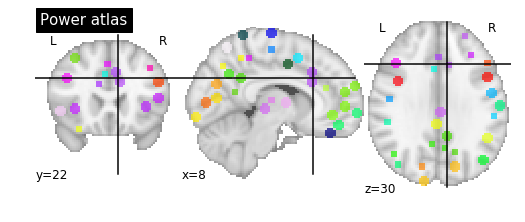

In [11]:
from nilearn import plotting

plotting.plot_roi('/Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz', title="Power atlas")

In [574]:
coords[5]

array([-21, -22, -20])

In [10]:
from nilearn.input_data import NiftiLabelsMasker
from nilearn.connectome import ConnectivityMeasure
from sklearn.covariance import EmpiricalCovariance
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
from mne.viz import plot_connectivity_circle
import re


def _fisher_r_to_z(x):
    import numpy as np
    # correct any rounding errors
    # correlations cannot be greater than 1.
    x = np.clip(x, -1, 1)

    return np.arctanh(x)

for subject in subjects[-7:]:
    print(subject)
    out_dir=nibs_dir + '/sub-' + subject + '/func/'
    os.chdir(out_dir)
    
    for trial_type in trial_types:
        # extract timeseries from every label

        if not os.path.exists(os.path.join(out_dir, 'sub-' + subject + '_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-' + trial_type + '_correlation.tsv')):
            
            try: 
                timeseries_file= out_dir + 'sub-' + subject + '_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-' + trial_type + '_betaseries.nii.gz'

                masker = NiftiLabelsMasker(labels_img=atlas_file,
                                           standardize=True, verbose=1)
                timeseries = masker.fit_transform(timeseries_file)
                # create correlation matrix
                correlation_measure = ConnectivityMeasure(cov_estimator=EmpiricalCovariance(),
                                                          kind="correlation")
                correlation_matrix = correlation_measure.fit_transform([timeseries])[0]
                np.fill_diagonal(correlation_matrix, np.NaN)

                # add the atlas labels to the matrix
                atlas_lut_df = pd.read_csv(atlas_lut, sep='\t')
                regions = atlas_lut_df['regions'].values
                correlation_matrix_df = pd.DataFrame(correlation_matrix, index=regions, columns=regions)

                # do a fisher's r -> z transform
                fisher_z_matrix_df = correlation_matrix_df.apply(_fisher_r_to_z)

                # write out the file.

                corr_mat_fname = 'sub-' + subject + '_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-' + trial_type + '_correlation.tsv'
                corr_mat_path = os.path.join(out_dir, corr_mat_fname)
                fisher_z_matrix_df.to_csv(corr_mat_path, sep='\t', na_rep='n/a')

                # visualizations with mne
                connmat = fisher_z_matrix_df.values
                labels = list(fisher_z_matrix_df.index)

                # plot a circle visualization of the correlation matrix
                viz_mat_fname = 'sub-' + subject + '_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-' + trial_type + '_correlation.svg'
                viz_mat_path = os.path.join(out_dir, viz_mat_fname)

                n_lines = int(np.sum(connmat > 0) / 2)
                fig = plt.figure(figsize=(5, 5))

                plot_connectivity_circle(connmat, labels, n_lines=n_lines, fig=fig, title='correlation %s concat' % trial_type,
                                         fontsize_title=10, facecolor='white', textcolor='black',
                                         colormap='jet', colorbar=1, node_colors=['black'],
                                         node_edgecolor=['white'], show=False, interactive=False)

                fig.savefig(viz_mat_path, dpi=300)
                plt.close()

            except Exception as e:
                print(e)



40778
[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40778/func/sub-40778_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40778/func/sub-40778_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-match_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40778/func/sub-40778_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-mismatch_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


40796
[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40796/func/sub-40796_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40796/func/sub-40796_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-match_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40796/func/sub-40796_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-mismatch_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


40803
[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40803/func/sub-40803_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/Users/PSYC-mcm5324/Library/Python/3.7/lib/python/site-packages/nilearn/connectome/connectivity_matrices.py:359: RuntimeWarning: divide by zero encountered in true_divide
  diagonal = np.atleast_2d(1. / np.sqrt(np.diag(covariance)))
/Users/PSYC-mcm5324/Library/Python/3.7/lib/python/site-packages/nilearn/connectome/connectivity_matrices.py:360: RuntimeWarning: invalid value encountered in multiply
  correlation = covariance * diagonal * diagonal.T
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater
/usr/local/lib/python3.7/site-packages/mne/viz/circle.py:305: RuntimeWarning: invalid value encountered in greater_equal
  con_draw_idx = np.where(con_abs >= con_thresh)[0]


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40803/func/sub-40803_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-match_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/Users/PSYC-mcm5324/Library/Python/3.7/lib/python/site-packages/nilearn/connectome/connectivity_matrices.py:359: RuntimeWarning: divide by zero encountered in true_divide
  diagonal = np.atleast_2d(1. / np.sqrt(np.diag(covariance)))
/Users/PSYC-mcm5324/Library/Python/3.7/lib/python/site-packages/nilearn/connectome/connectivity_matrices.py:360: RuntimeWarning: invalid value encountered in multiply
  correlation = covariance * diagonal * diagonal.T
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater
/usr/local/lib/python3.7/site-packages/mne/viz/circle.py:305: RuntimeWarning: invalid value encountered in greater_equal
  con_draw_idx = np.where(con_abs >= con_thresh)[0]


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40803/func/sub-40803_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-mismatch_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/Users/PSYC-mcm5324/Library/Python/3.7/lib/python/site-packages/nilearn/connectome/connectivity_matrices.py:359: RuntimeWarning: divide by zero encountered in true_divide
  diagonal = np.atleast_2d(1. / np.sqrt(np.diag(covariance)))
/Users/PSYC-mcm5324/Library/Python/3.7/lib/python/site-packages/nilearn/connectome/connectivity_matrices.py:360: RuntimeWarning: invalid value encountered in multiply
  correlation = covariance * diagonal * diagonal.T
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater
/usr/local/lib/python3.7/site-packages/mne/viz/circle.py:305: RuntimeWarning: invalid value encountered in greater_equal
  con_draw_idx = np.where(con_abs >= con_thresh)[0]


40855
[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40855/func/sub-40855_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40855/func/sub-40855_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-match_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40855/func/sub-40855_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-mismatch_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


40861
[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40861/func/sub-40861_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40861/func/sub-40861_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-match_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40861/func/sub-40861_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-mismatch_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


40961
[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40961/func/sub-40961_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40961/func/sub-40961_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-match_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40961/func/sub-40961_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-mismatch_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


40968
[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40968/func/sub-40968_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40968/func/sub-40968_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-match_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


[NiftiLabelsMasker.fit_transform] loading data from /Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz
Resampling labels
[NiftiLabelsMasker.transform_single_imgs] Loading data from /Volumes/psybrain/ADM/derivatives/nibs/nibetaseries/sub-40968/func/sub-40968_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-mismatch_betaseries.nii.gz
[NiftiLabelsMasker.transform_single_imgs] Extracting region signals
[NiftiLabelsMasker.transform_single_imgs] Cleaning extracted signals


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in greater


[BCT User Guide](https://sites.google.com/site/bctnet/Home/help)

In [181]:
glob.glob(nibs_dir + '/sub-*/func/sub-*_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_correlation.tsv')

['/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries_old/sub-30096/func/sub-30096_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_correlation.tsv',
 '/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries_old/sub-30432/func/sub-30432_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_correlation.tsv',
 '/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries_old/sub-30074/func/sub-30074_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_correlation.tsv',
 '/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries_old/sub-30330/func/sub-30330_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_correlation.tsv',
 '/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries_old/sub-30009/func/sub-30009_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_correlation.tsv',
 '/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries_old/sub-30181/func/sub-30181_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-cue_correlation.tsv',
 '/Volumes/psybrain/ADM/derivative


cue
30004
(264, 264)
i = 0


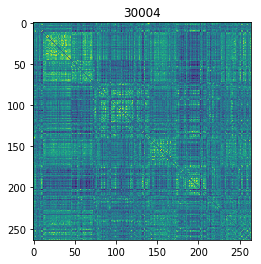

j = 0 


30008
(264, 264)
i = 1


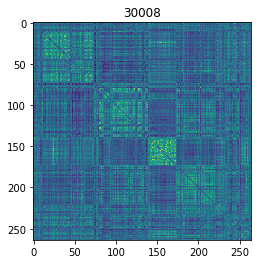

j = 1 


30009
(264, 264)
i = 2


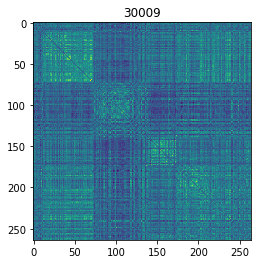

j = 2 


30015
(264, 264)
i = 3


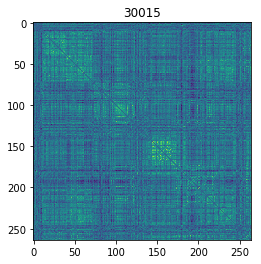

j = 3 


30019
(264, 264)
i = 4


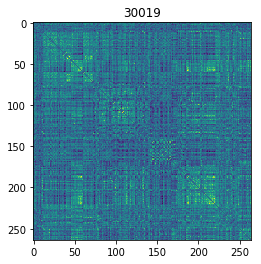

j = 4 


30020
(264, 264)
i = 5


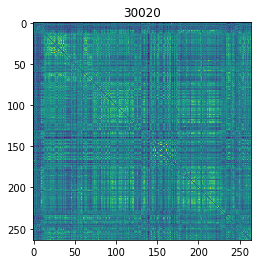

j = 5 


30023
(264, 264)
i = 6


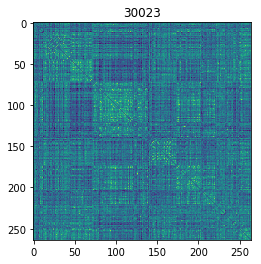

j = 6 


30040
(264, 264)
i = 7


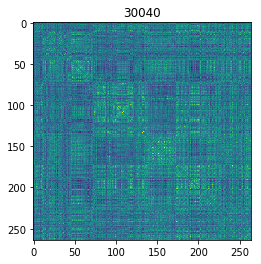

j = 7 


30057
(264, 264)
i = 8


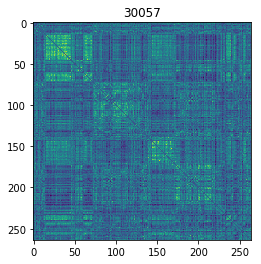

j = 8 


30064
(264, 264)
i = 9


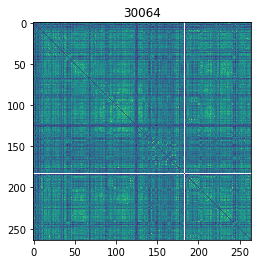

j = 9 


30066
(264, 264)
i = 10


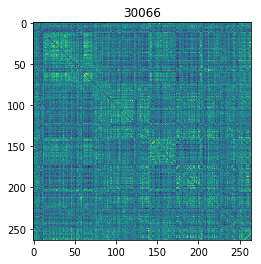

j = 10 


30069
(264, 264)
i = 11


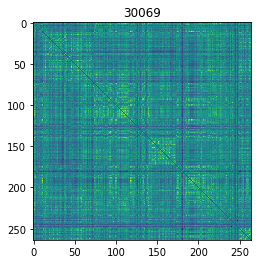

j = 11 


30074
(264, 264)
i = 12


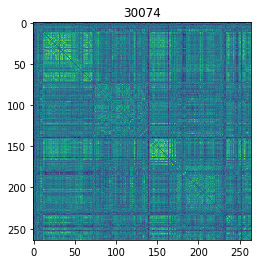

j = 12 


30085
(264, 264)
i = 13


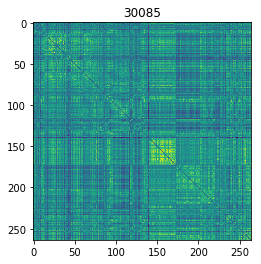

j = 13 


30088
(264, 264)
i = 14


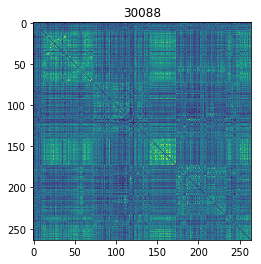

j = 14 


30090
(264, 264)
i = 15


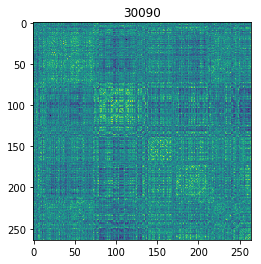

j = 15 


30091
(264, 264)
i = 16


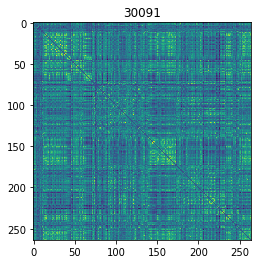

j = 16 


30095
(264, 264)
i = 17


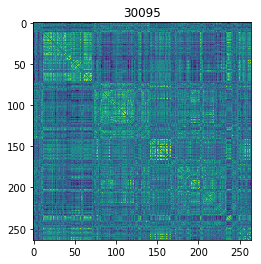

j = 17 


30096
(264, 264)
i = 18


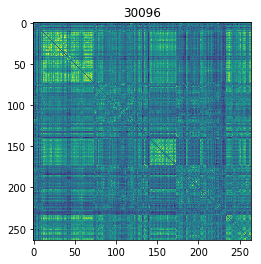

j = 18 


30105
(264, 264)
i = 19


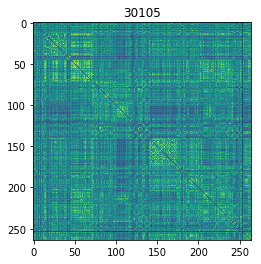

j = 19 


30116
(264, 264)
i = 20


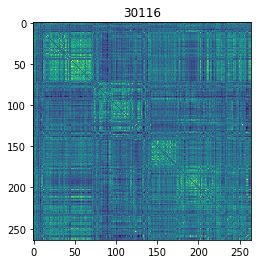

j = 20 


30118
(264, 264)
i = 21


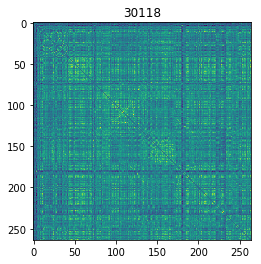

j = 21 


30119
(264, 264)
i = 22


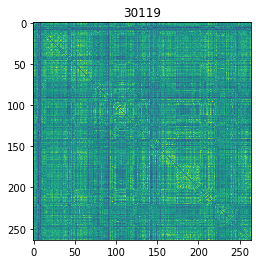

j = 22 


30128
(264, 264)
i = 23


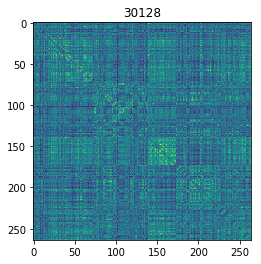

j = 23 


30181
(264, 264)
i = 24


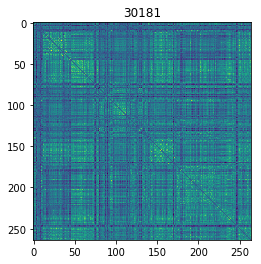

j = 24 


30217
(264, 264)
i = 25


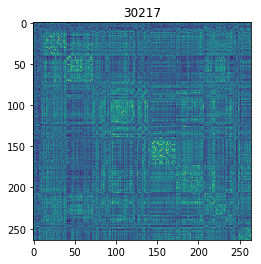

j = 25 


30227
(264, 264)
i = 26


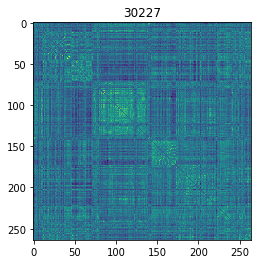

j = 26 


30236
(264, 264)
i = 27


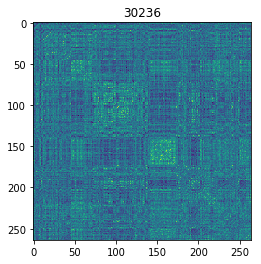

j = 27 


30242
(264, 264)
i = 28


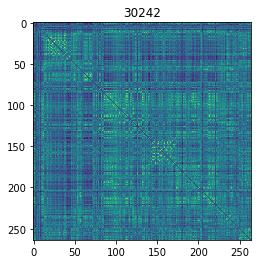

j = 28 


30255
(264, 264)
i = 29


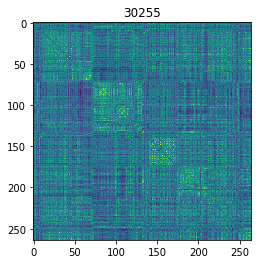

j = 29 


30274
(264, 264)
i = 30


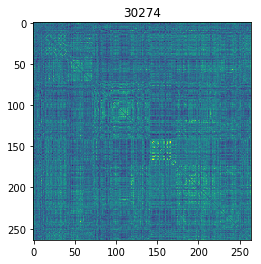

j = 30 


30283
(264, 264)
i = 31


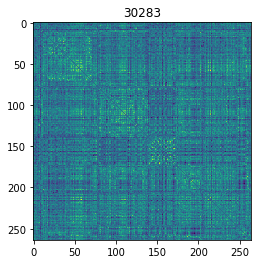

j = 31 


30295
(264, 264)
i = 32


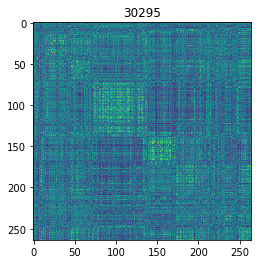

j = 32 


30330
(264, 264)
i = 33


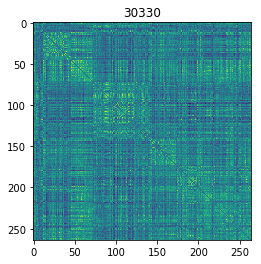

j = 33 


30346
(264, 264)
i = 34


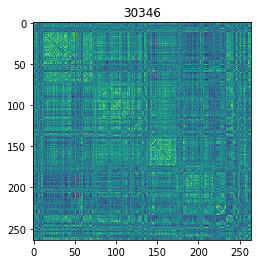

j = 34 


30376
(264, 264)
i = 35


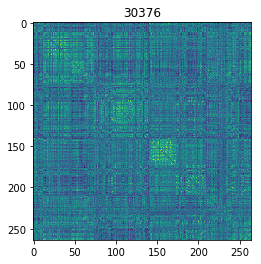

j = 35 


30395
(264, 264)
i = 36


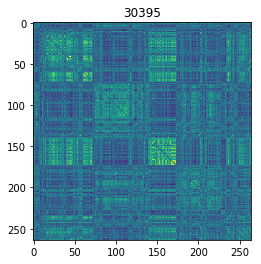

j = 36 


30400
(264, 264)
i = 37


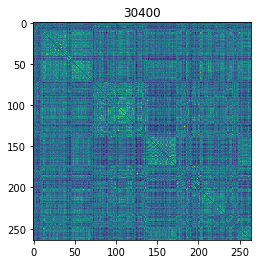

j = 37 


30403
(264, 264)
i = 38


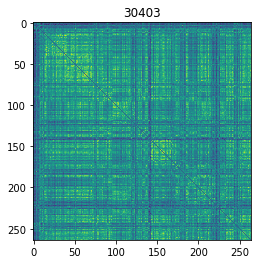

j = 38 


30412
(264, 264)
i = 39


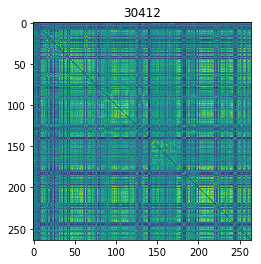

j = 39 


30426
(264, 264)
i = 40


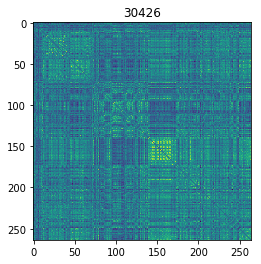

j = 40 


30432
(264, 264)
i = 41


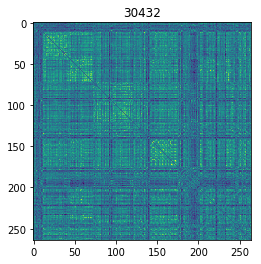

j = 41 


30466
(264, 264)
i = 42


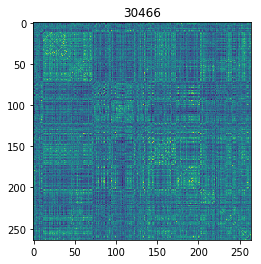

j = 42 


30469
(264, 264)
i = 43


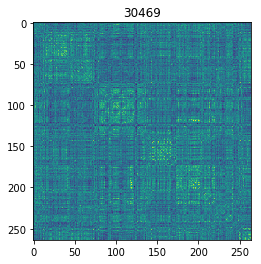

j = 43 


30476
30478
(264, 264)
i = 44


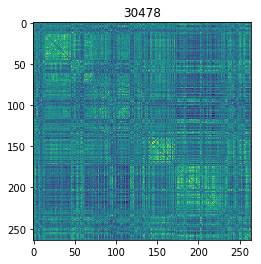

j = 44 


30568
(264, 264)
i = 45


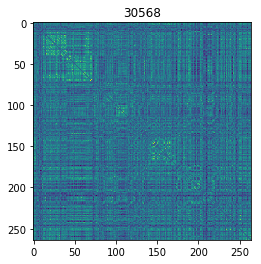

j = 45 


30570
(264, 264)
i = 46


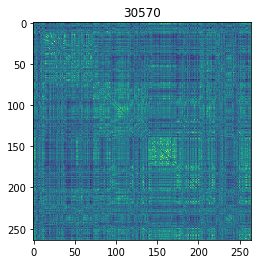

j = 46 


30581
(264, 264)
i = 47


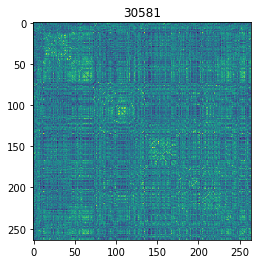

j = 47 


30584
(264, 264)
i = 48


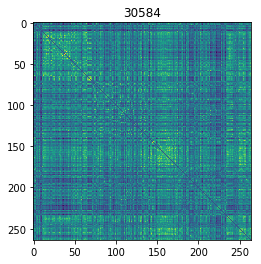

j = 48 


30588
(264, 264)
i = 49


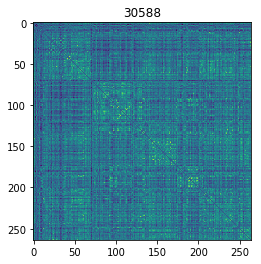

j = 49 


40160
(264, 264)
i = 50


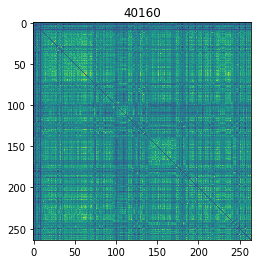

k = 0 


40170
(264, 264)
i = 51


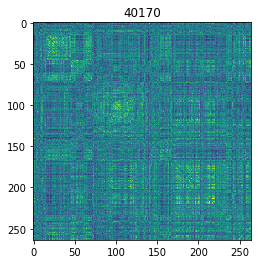

k = 1 


40175
(264, 264)
i = 52


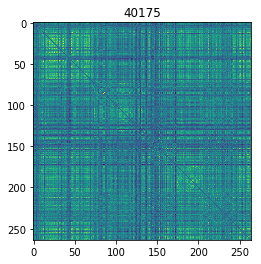

k = 2 


40288
(264, 264)
i = 53


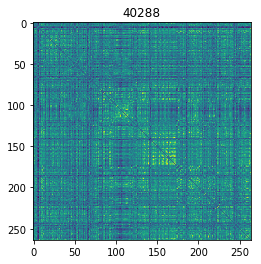

k = 3 


40351
(264, 264)
i = 54


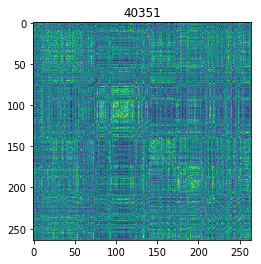

k = 4 


40490
(264, 264)
i = 55


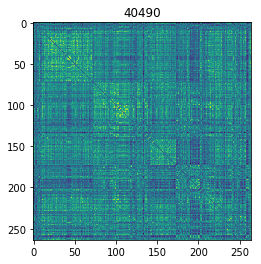

k = 5 


40512
(264, 264)
i = 56


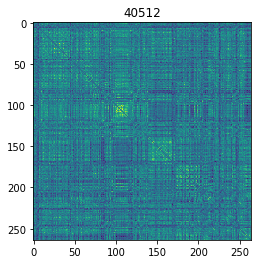

k = 6 


40519
(264, 264)
i = 57


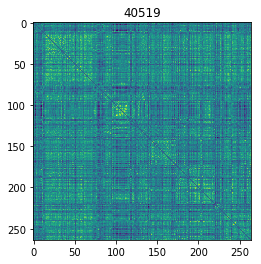

k = 7 


40520
(264, 264)
i = 58


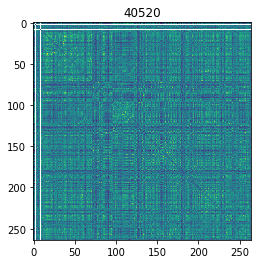

k = 8 


40524
(264, 264)
i = 59


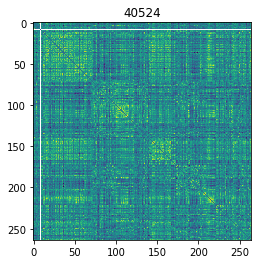

k = 9 


40547
(264, 264)
i = 60


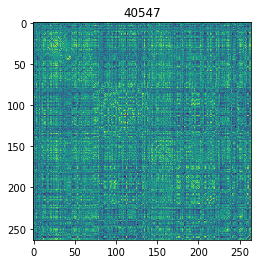

k = 10 


40564
(264, 264)
i = 61


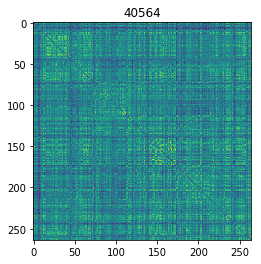

k = 11 


40615
(264, 264)
i = 62


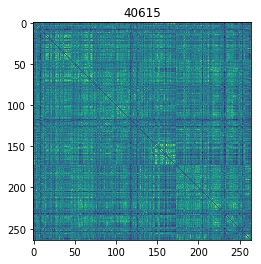

k = 12 


40619
(264, 264)
i = 63


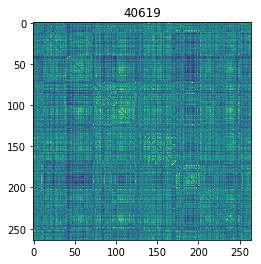

k = 13 


40624
(264, 264)
i = 64


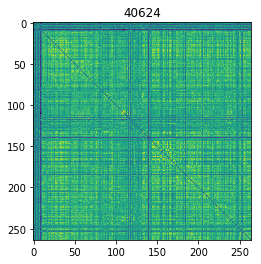

k = 14 


40638
(264, 264)
i = 65


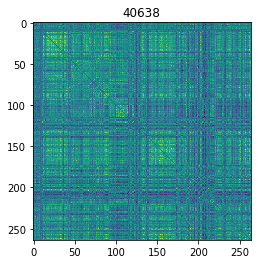

k = 15 


40649
(264, 264)
i = 66


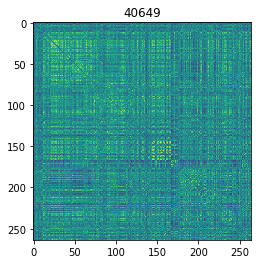

k = 16 


40650
(264, 264)
i = 67


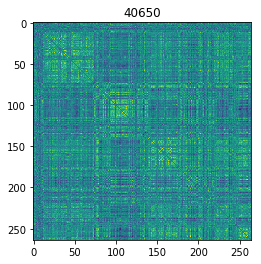

k = 17 


40656
(264, 264)
i = 68


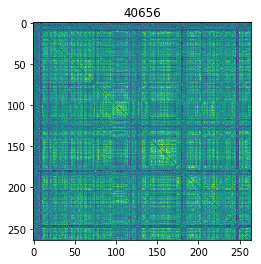

k = 18 


40658
(264, 264)
i = 69


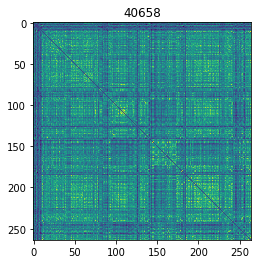

k = 19 


40664
(264, 264)
i = 70


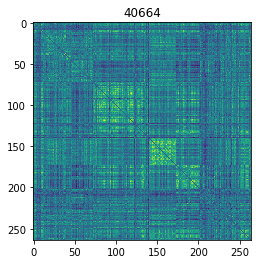

k = 20 


40665
(264, 264)
i = 71


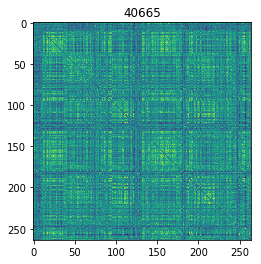

k = 21 


40668
(264, 264)
i = 72


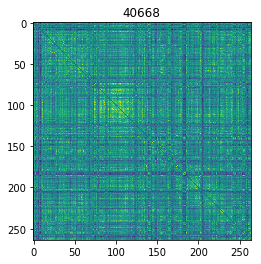

k = 22 


40672
(264, 264)
i = 73


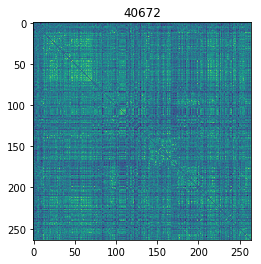

k = 23 


40685
(264, 264)
i = 74


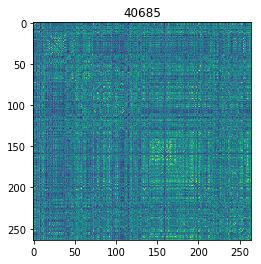

k = 24 


40694
(264, 264)
i = 75


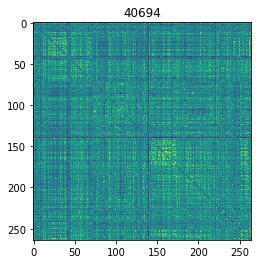

k = 25 


40720
(264, 264)
i = 76


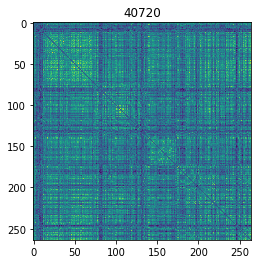

k = 26 


40738
(264, 264)
i = 77


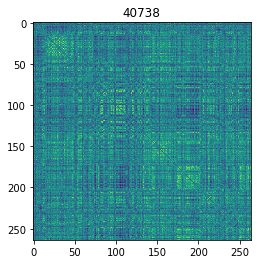

k = 27 


40743
(264, 264)
i = 78


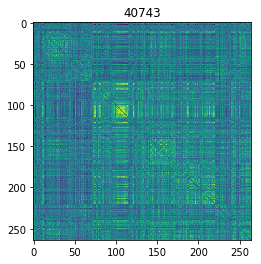

k = 28 


40750
(264, 264)
i = 79


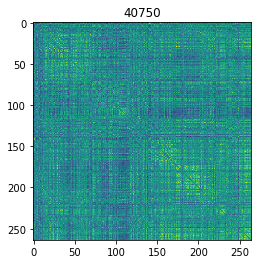

k = 29 


40778
(264, 264)
i = 80


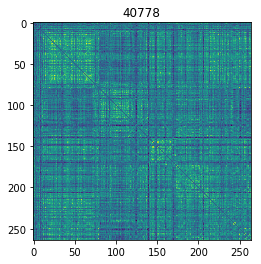

k = 30 


40796
(264, 264)
i = 81


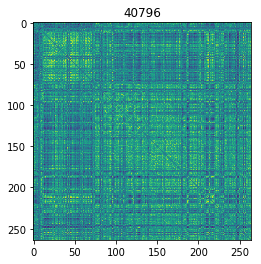

k = 31 


40803
(264, 264)
i = 82


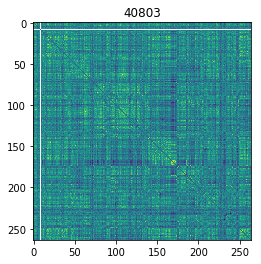

k = 32 


40855
(264, 264)
i = 83


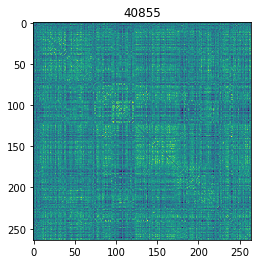

k = 33 


40861
(264, 264)
i = 84


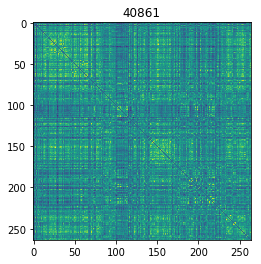

k = 34 


40961
(264, 264)
i = 85


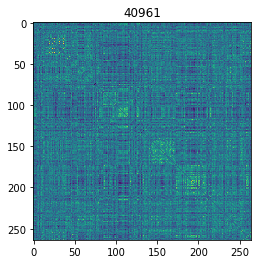

k = 35 


40968
(264, 264)
i = 86


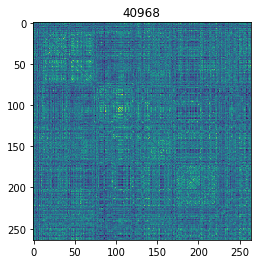

k = 36 



match
30004
(264, 264)
i = 0


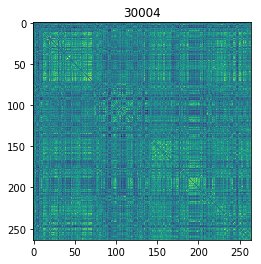

j = 0 


30008
(264, 264)
i = 1


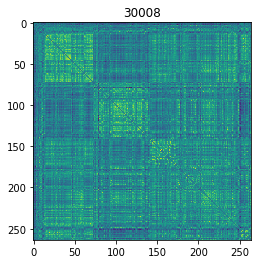

j = 1 


30009
(264, 264)
i = 2


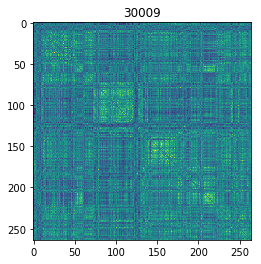

j = 2 


30015
(264, 264)
i = 3


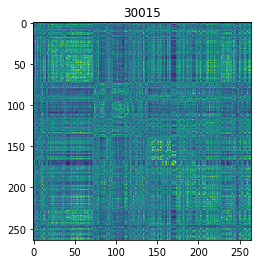

j = 3 


30019
(264, 264)
i = 4


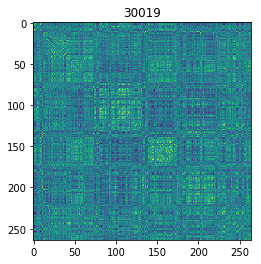

j = 4 


30020
(264, 264)
i = 5


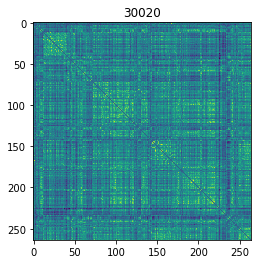

j = 5 


30023
(264, 264)
i = 6


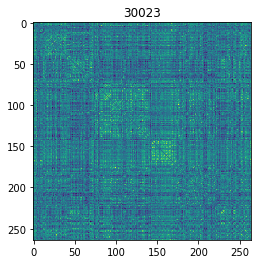

j = 6 


30040
(264, 264)
i = 7


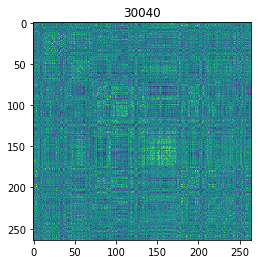

j = 7 


30057
(264, 264)
i = 8


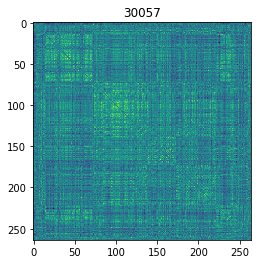

j = 8 


30064
(264, 264)
i = 9


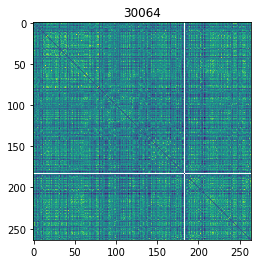

j = 9 


30066
(264, 264)
i = 10


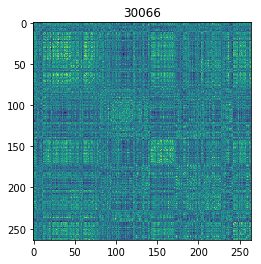

j = 10 


30069
(264, 264)
i = 11


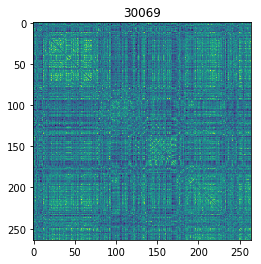

j = 11 


30074
(264, 264)
i = 12


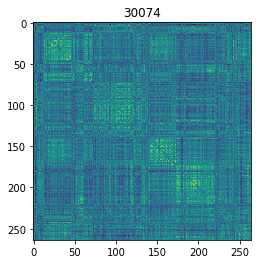

j = 12 


30085
(264, 264)
i = 13


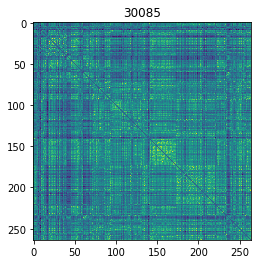

j = 13 


30088
(264, 264)
i = 14


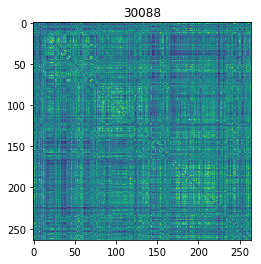

j = 14 


30090
(264, 264)
i = 15


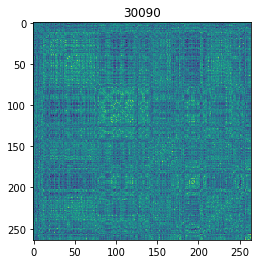

j = 15 


30091
(264, 264)
i = 16


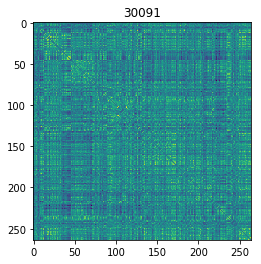

j = 16 


30095
(264, 264)
i = 17


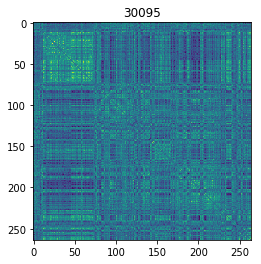

j = 17 


30096
(264, 264)
i = 18


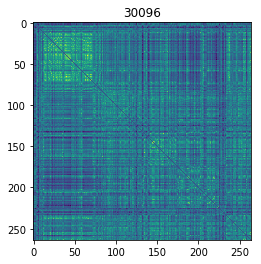

j = 18 


30105
(264, 264)
i = 19


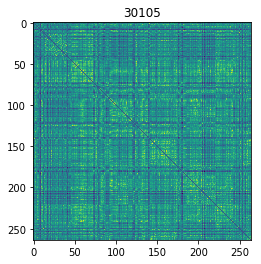

j = 19 


30116
(264, 264)
i = 20


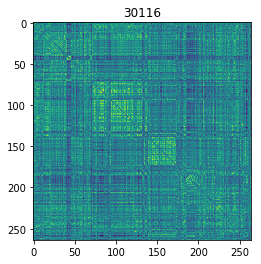

j = 20 


30118
(264, 264)
i = 21


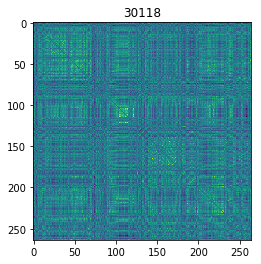

j = 21 


30119
(264, 264)
i = 22


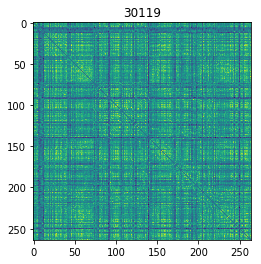

j = 22 


30128
(264, 264)
i = 23


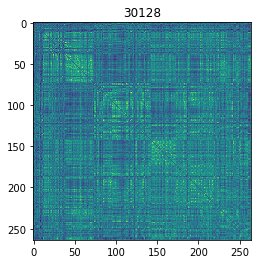

j = 23 


30181
(264, 264)
i = 24


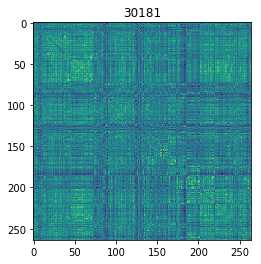

j = 24 


30217
(264, 264)
i = 25


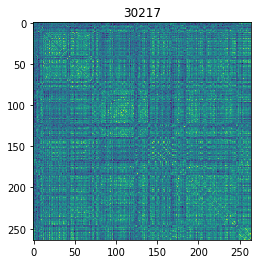

j = 25 


30227
(264, 264)
i = 26


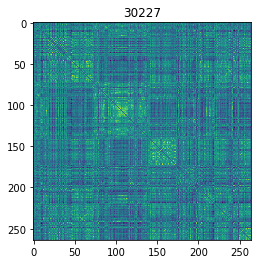

j = 26 


30236
(264, 264)
i = 27


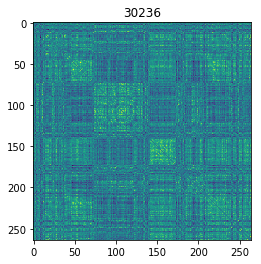

j = 27 


30242
(264, 264)
i = 28


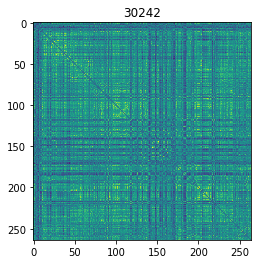

j = 28 


30255
(264, 264)
i = 29


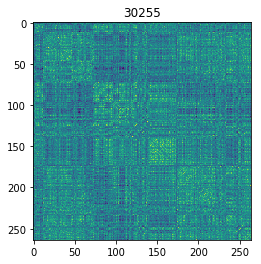

j = 29 


30274
(264, 264)
i = 30


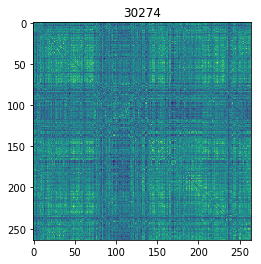

j = 30 


30283
(264, 264)
i = 31


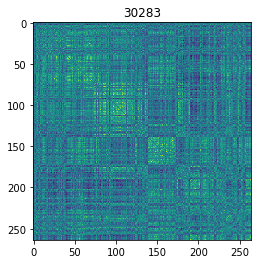

j = 31 


30295
(264, 264)
i = 32


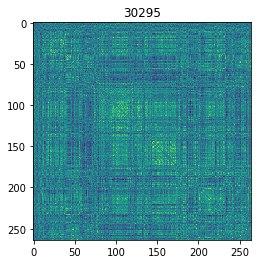

j = 32 


30330
(264, 264)
i = 33


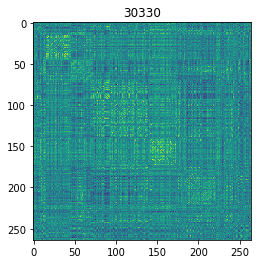

j = 33 


30346
(264, 264)
i = 34


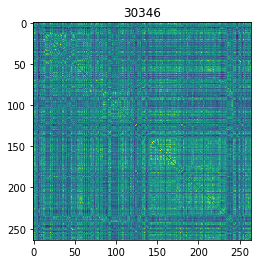

j = 34 


30376
(264, 264)
i = 35


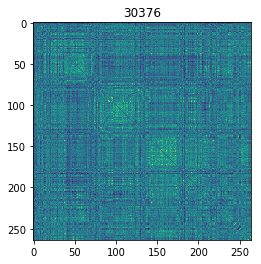

j = 35 


30395
(264, 264)
i = 36


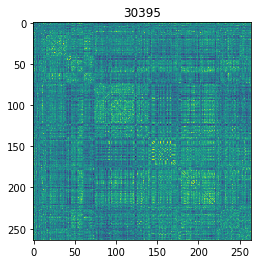

j = 36 


30400
(264, 264)
i = 37


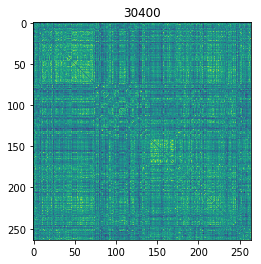

j = 37 


30403
(264, 264)
i = 38


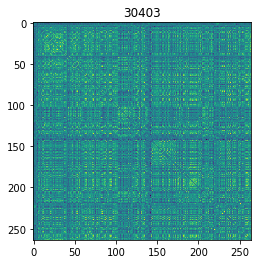

j = 38 


30412
(264, 264)
i = 39


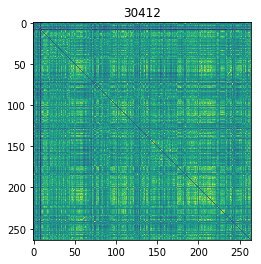

j = 39 


30426
(264, 264)
i = 40


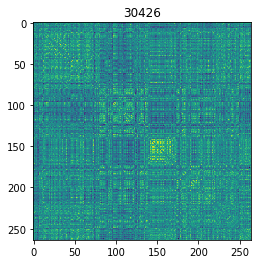

j = 40 


30432
(264, 264)
i = 41


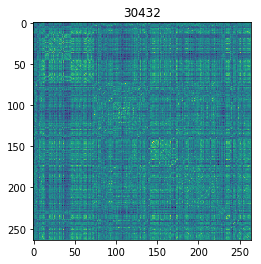

j = 41 


30466
(264, 264)
i = 42


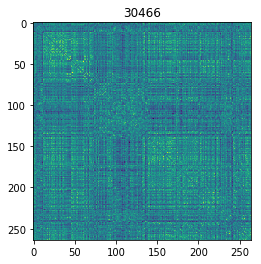

j = 42 


30469
(264, 264)
i = 43


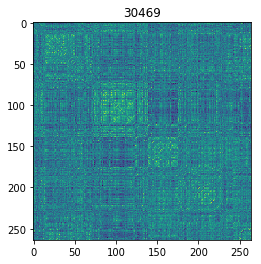

j = 43 


30476
30478
(264, 264)
i = 44


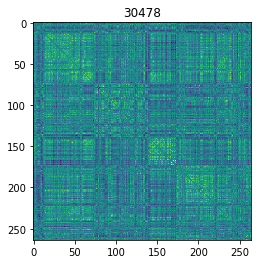

j = 44 


30568
(264, 264)
i = 45


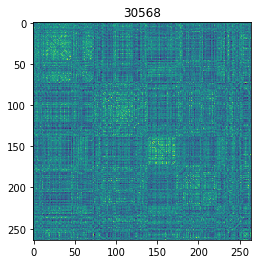

j = 45 


30570
(264, 264)
i = 46


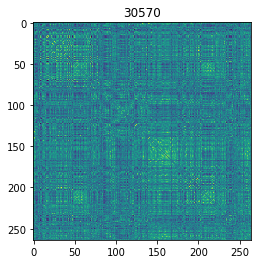

j = 46 


30581
(264, 264)
i = 47


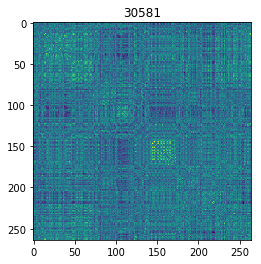

j = 47 


30584
(264, 264)
i = 48


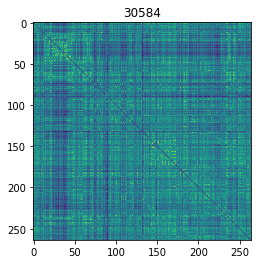

j = 48 


30588
(264, 264)
i = 49


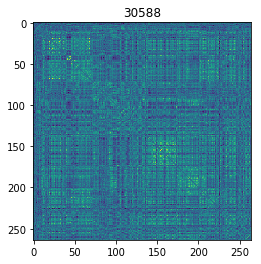

j = 49 


40160
(264, 264)
i = 50


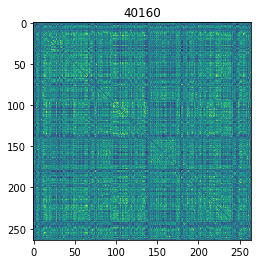

k = 0 


40170
(264, 264)
i = 51


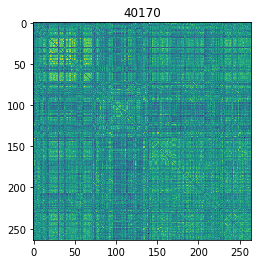

k = 1 


40175
(264, 264)
i = 52


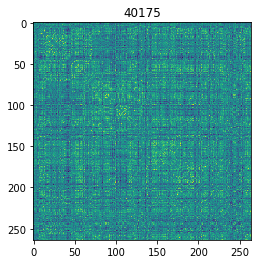

k = 2 


40288
(264, 264)
i = 53


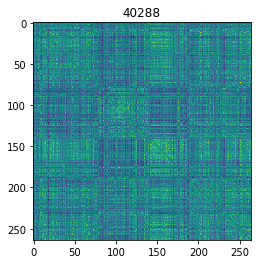

k = 3 


40351
(264, 264)
i = 54


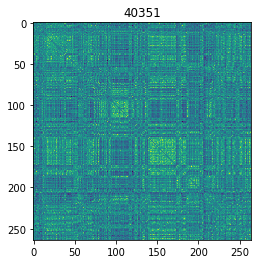

k = 4 


40490
(264, 264)
i = 55


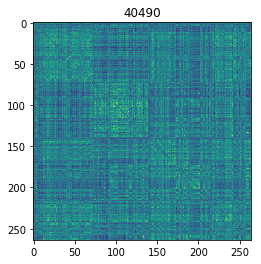

k = 5 


40512
(264, 264)
i = 56


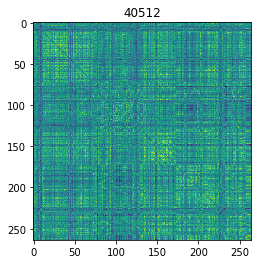

k = 6 


40519
(264, 264)
i = 57


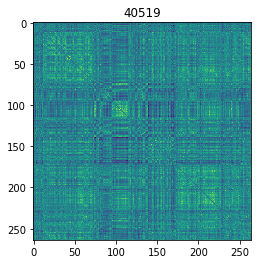

k = 7 


40520
(264, 264)
i = 58


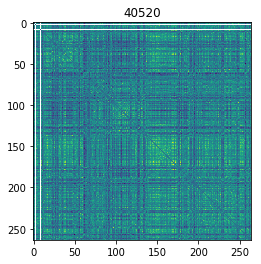

k = 8 


40524
(264, 264)
i = 59


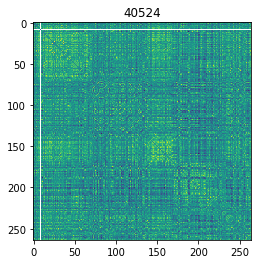

k = 9 


40547
(264, 264)
i = 60


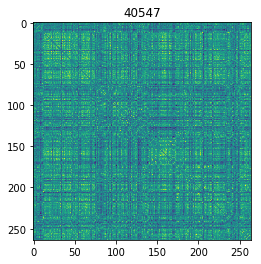

k = 10 


40564
(264, 264)
i = 61


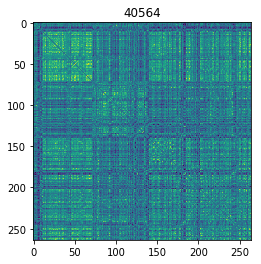

k = 11 


40615
(264, 264)
i = 62


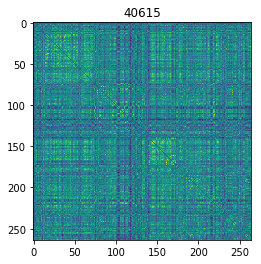

k = 12 


40619
(264, 264)
i = 63


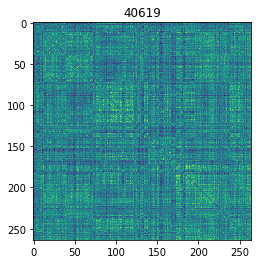

k = 13 


40624
(264, 264)
i = 64


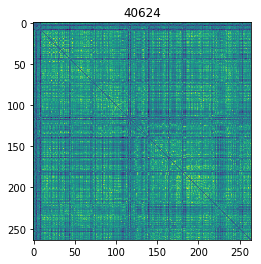

k = 14 


40638
(264, 264)
i = 65


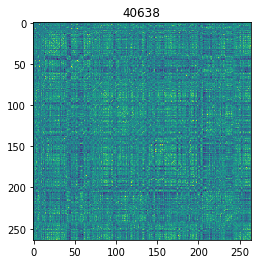

k = 15 


40649
(264, 264)
i = 66


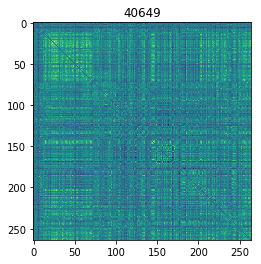

k = 16 


40650
(264, 264)
i = 67


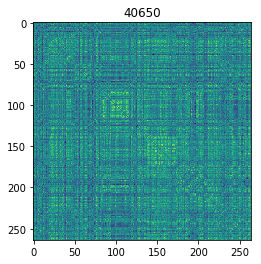

k = 17 


40656
(264, 264)
i = 68


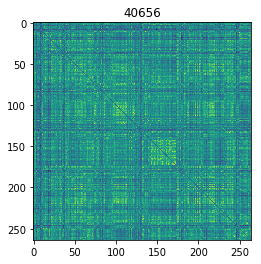

k = 18 


40658
(264, 264)
i = 69


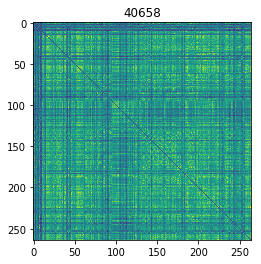

k = 19 


40664
(264, 264)
i = 70


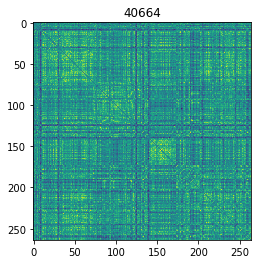

k = 20 


40665
(264, 264)
i = 71


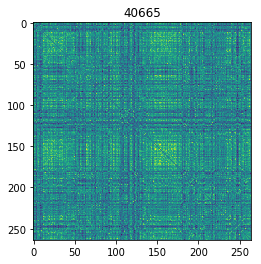

k = 21 


40668
(264, 264)
i = 72


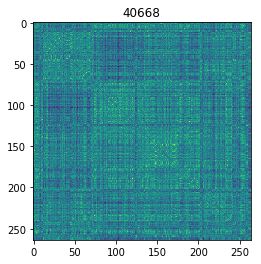

k = 22 


40672
(264, 264)
i = 73


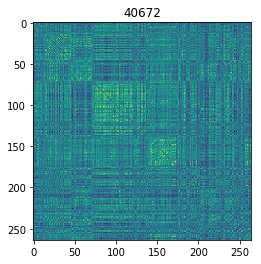

k = 23 


40685
(264, 264)
i = 74


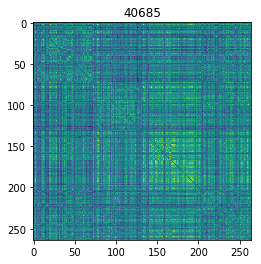

k = 24 


40694
(264, 264)
i = 75


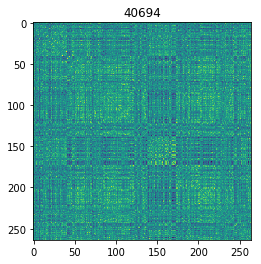

k = 25 


40720
(264, 264)
i = 76


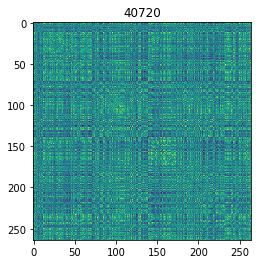

k = 26 


40738
(264, 264)
i = 77


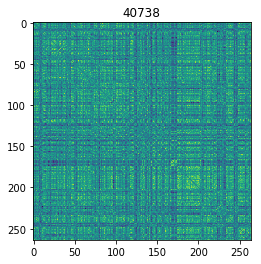

k = 27 


40743
(264, 264)
i = 78


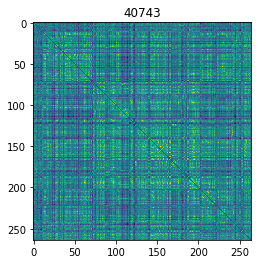

k = 28 


40750
(264, 264)
i = 79


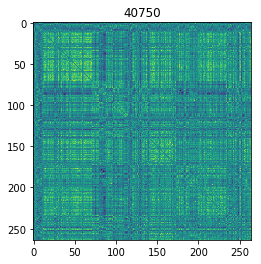

k = 29 


40778
(264, 264)
i = 80


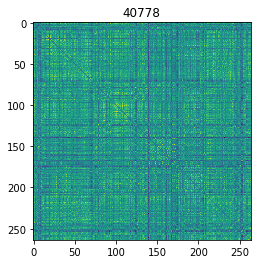

k = 30 


40796
(264, 264)
i = 81


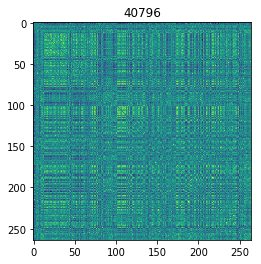

k = 31 


40803
(264, 264)
i = 82


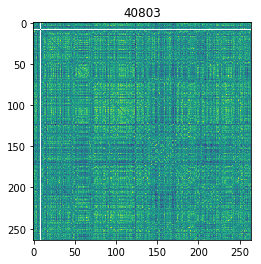

k = 32 


40855
(264, 264)
i = 83


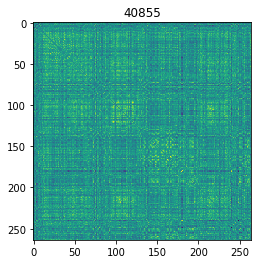

k = 33 


40861
(264, 264)
i = 84


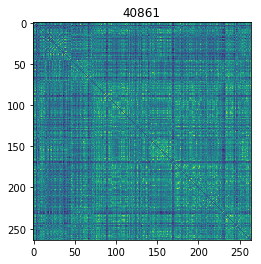

k = 34 


40961
(264, 264)
i = 85


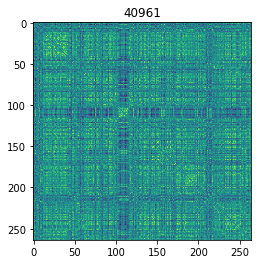

k = 35 


40968
(264, 264)
i = 86


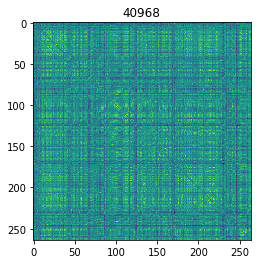

k = 36 



mismatch
30004
(264, 264)
i = 0


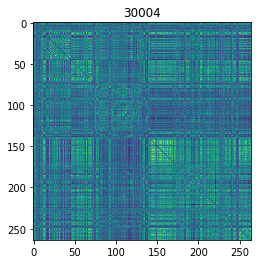

j = 0 


30008
(264, 264)
i = 1


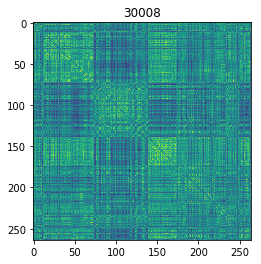

j = 1 


30009
(264, 264)
i = 2


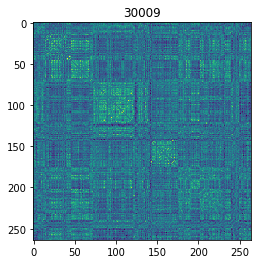

j = 2 


30015
(264, 264)
i = 3


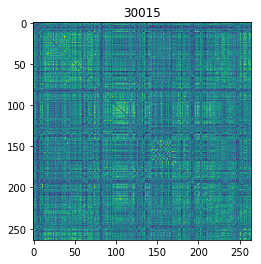

j = 3 


30019
(264, 264)
i = 4


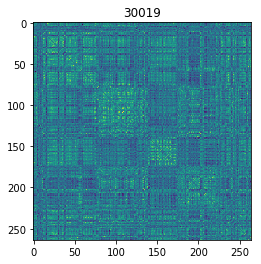

j = 4 


30020
(264, 264)
i = 5


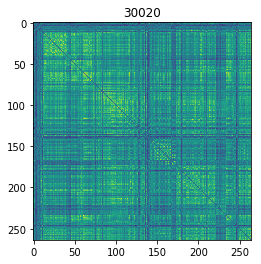

j = 5 


30023
(264, 264)
i = 6


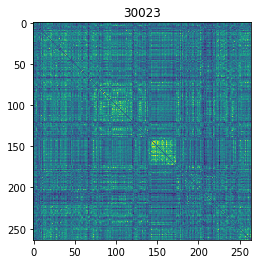

j = 6 


30040
(264, 264)
i = 7


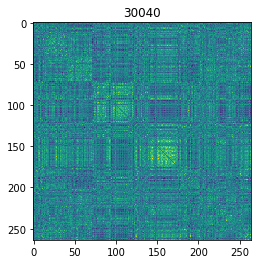

j = 7 


30057
(264, 264)
i = 8


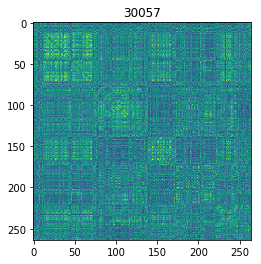

j = 8 


30064
(264, 264)
i = 9


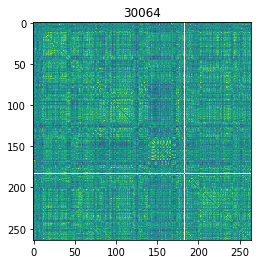

j = 9 


30066
(264, 264)
i = 10


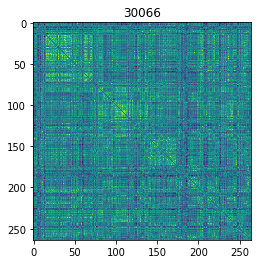

j = 10 


30069
(264, 264)
i = 11


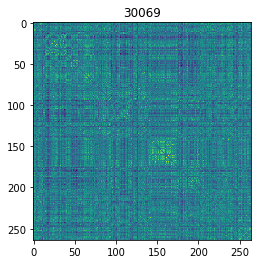

j = 11 


30074
(264, 264)
i = 12


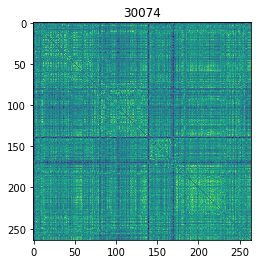

j = 12 


30085
(264, 264)
i = 13


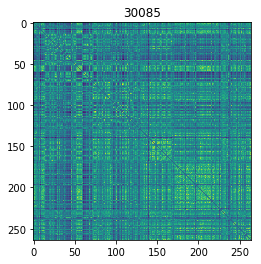

j = 13 


30088
(264, 264)
i = 14


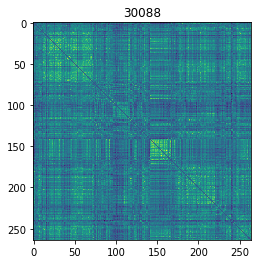

j = 14 


30090
(264, 264)
i = 15


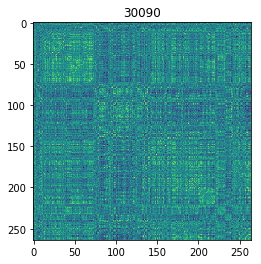

j = 15 


30091
(264, 264)
i = 16


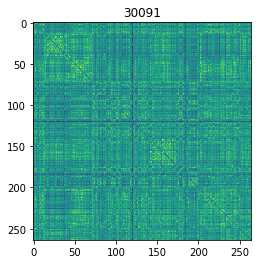

j = 16 


30095
(264, 264)
i = 17


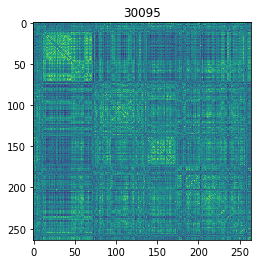

j = 17 


30096
(264, 264)
i = 18


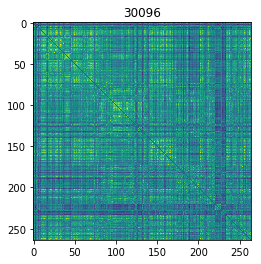

j = 18 


30105
(264, 264)
i = 19


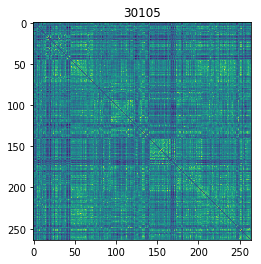

j = 19 


30116
(264, 264)
i = 20


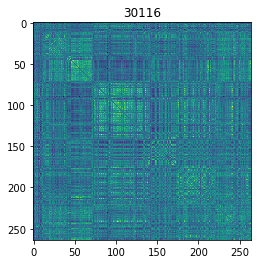

j = 20 


30118
(264, 264)
i = 21


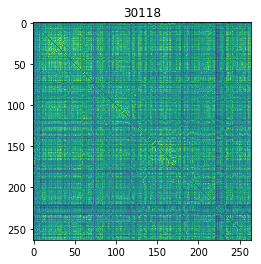

j = 21 


30119
(264, 264)
i = 22


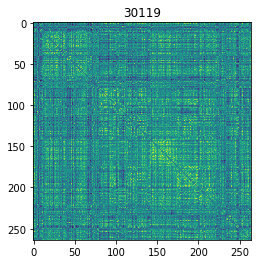

j = 22 


30128
(264, 264)
i = 23


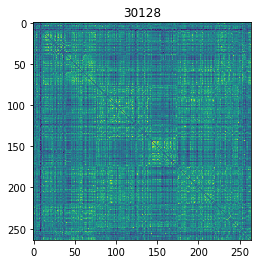

j = 23 


30181
(264, 264)
i = 24


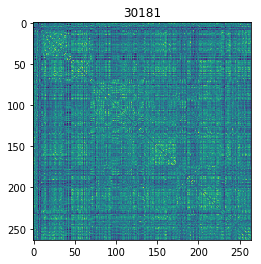

j = 24 


30217
(264, 264)
i = 25


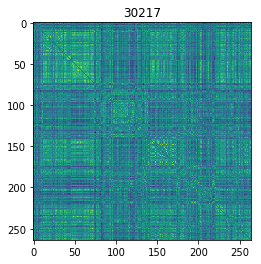

j = 25 


30227
(264, 264)
i = 26


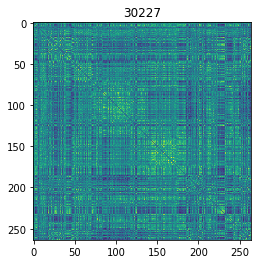

j = 26 


30236
(264, 264)
i = 27


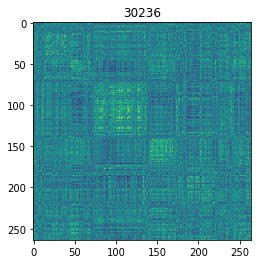

j = 27 


30242
(264, 264)
i = 28


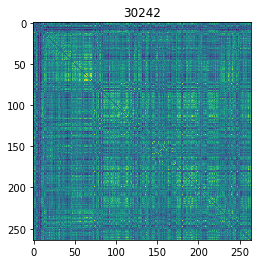

j = 28 


30255
(264, 264)
i = 29


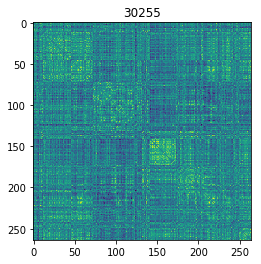

j = 29 


30274
(264, 264)
i = 30


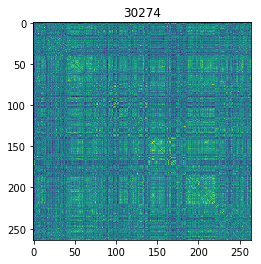

j = 30 


30283
(264, 264)
i = 31


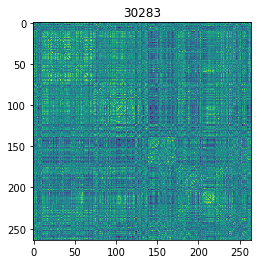

j = 31 


30295
(264, 264)
i = 32


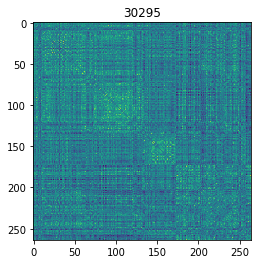

j = 32 


30330
(264, 264)
i = 33


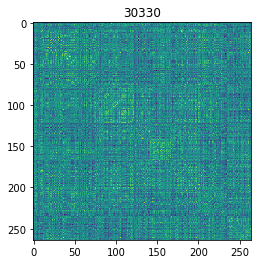

j = 33 


30346
(264, 264)
i = 34


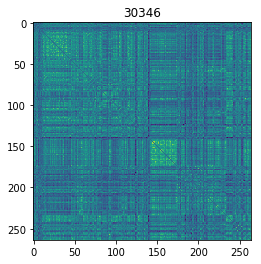

j = 34 


30376
(264, 264)
i = 35


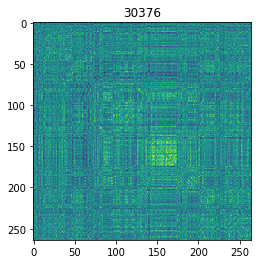

j = 35 


30395
(264, 264)
i = 36


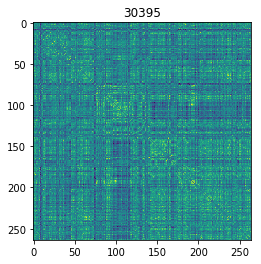

j = 36 


30400
(264, 264)
i = 37


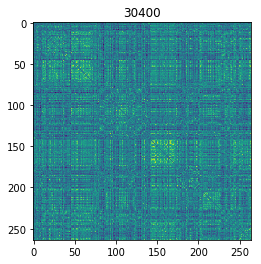

j = 37 


30403
(264, 264)
i = 38


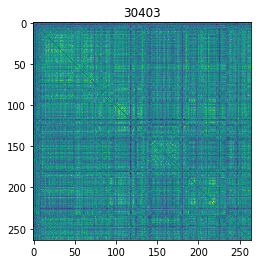

j = 38 


30412
(264, 264)
i = 39


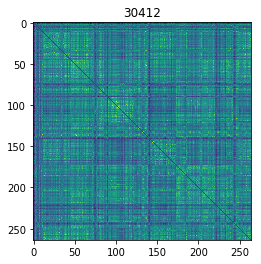

j = 39 


30426
(264, 264)
i = 40


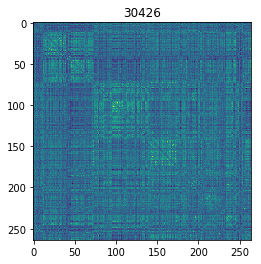

j = 40 


30432
(264, 264)
i = 41


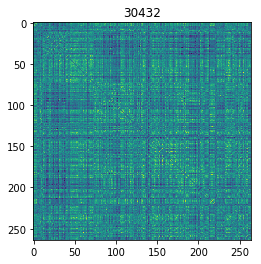

j = 41 


30466
(264, 264)
i = 42


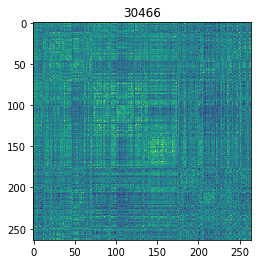

j = 42 


30469
(264, 264)
i = 43


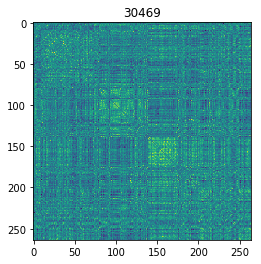

j = 43 


30476
30478
(264, 264)
i = 44


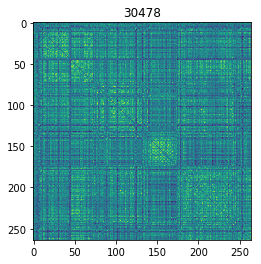

j = 44 


30568
(264, 264)
i = 45


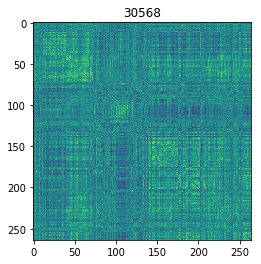

j = 45 


30570
(264, 264)
i = 46


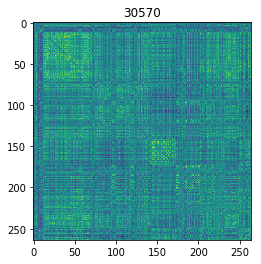

j = 46 


30581
(264, 264)
i = 47


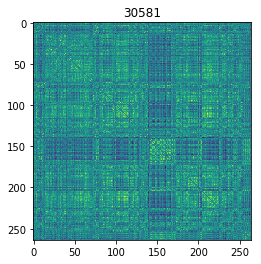

j = 47 


30584
(264, 264)
i = 48


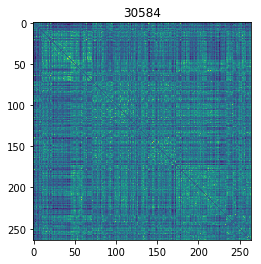

j = 48 


30588
(264, 264)
i = 49


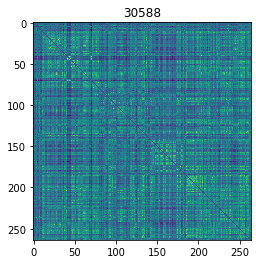

j = 49 


40160
(264, 264)
i = 50


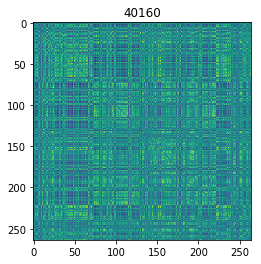

k = 0 


40170
(264, 264)
i = 51


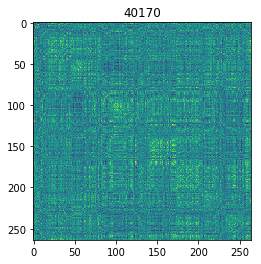

k = 1 


40175
(264, 264)
i = 52


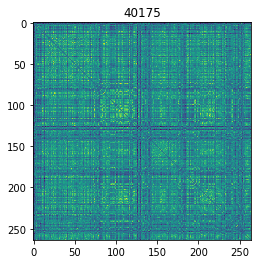

k = 2 


40288
(264, 264)
i = 53


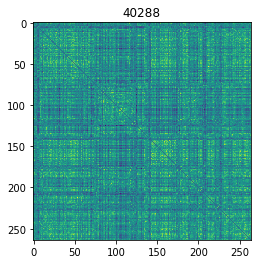

k = 3 


40351
(264, 264)
i = 54


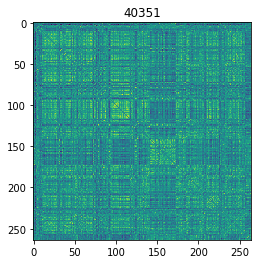

k = 4 


40490
(264, 264)
i = 55


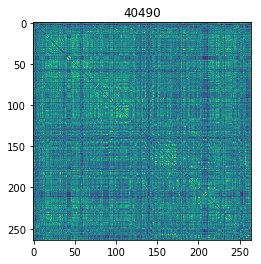

k = 5 


40512
(264, 264)
i = 56


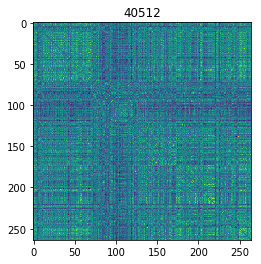

k = 6 


40519
(264, 264)
i = 57


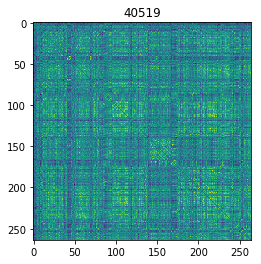

k = 7 


40520
(264, 264)
i = 58


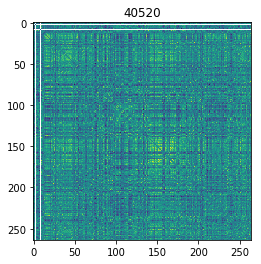

k = 8 


40524
(264, 264)
i = 59


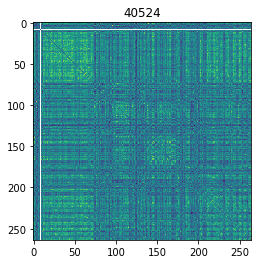

k = 9 


40547
(264, 264)
i = 60


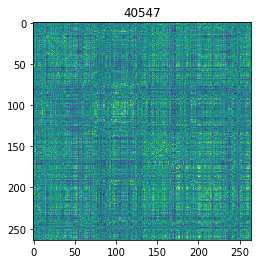

k = 10 


40564
(264, 264)
i = 61


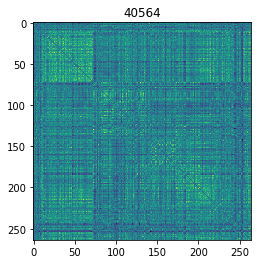

k = 11 


40615
(264, 264)
i = 62


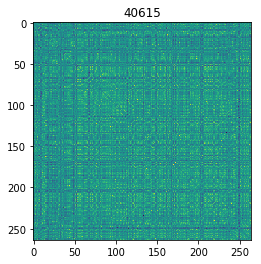

k = 12 


40619
(264, 264)
i = 63


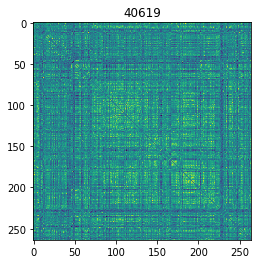

k = 13 


40624
(264, 264)
i = 64


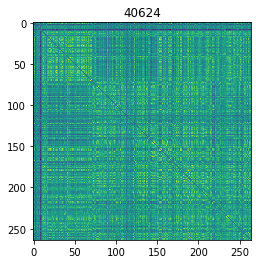

k = 14 


40638
(264, 264)
i = 65


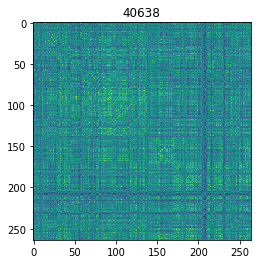

k = 15 


40649
(264, 264)
i = 66


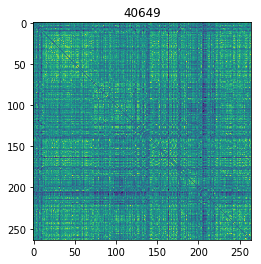

k = 16 


40650
(264, 264)
i = 67


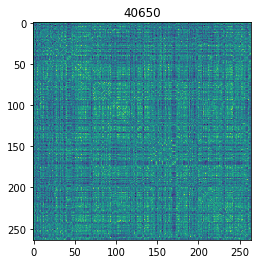

k = 17 


40656
(264, 264)
i = 68


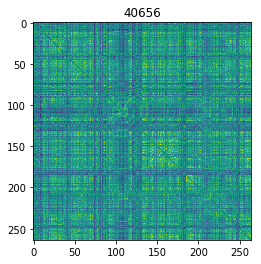

k = 18 


40658
(264, 264)
i = 69


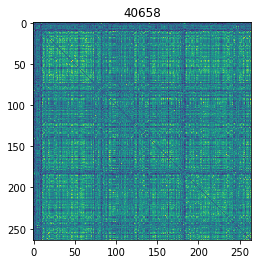

k = 19 


40664
(264, 264)
i = 70


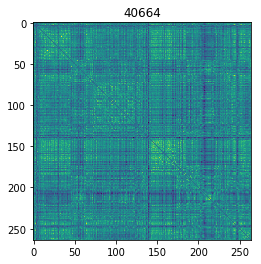

k = 20 


40665
(264, 264)
i = 71


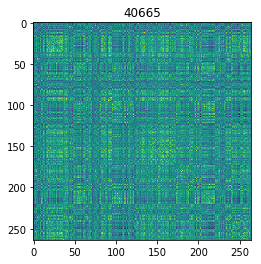

k = 21 


40668
(264, 264)
i = 72


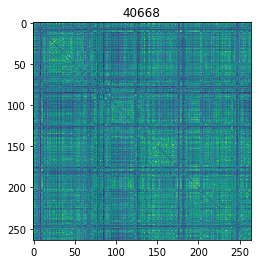

k = 22 


40672
(264, 264)
i = 73


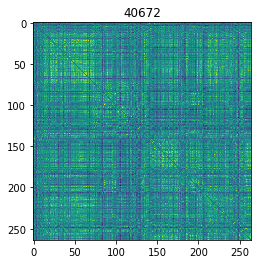

k = 23 


40685
(264, 264)
i = 74


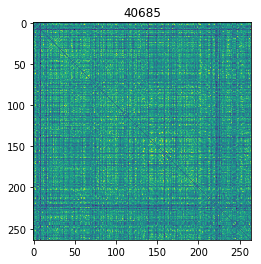

k = 24 


40694
(264, 264)
i = 75


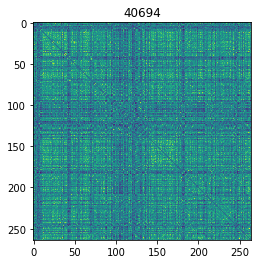

k = 25 


40720
(264, 264)
i = 76


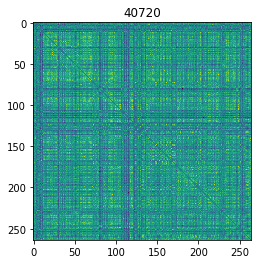

k = 26 


40738
(264, 264)
i = 77


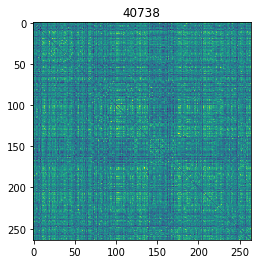

k = 27 


40743
(264, 264)
i = 78


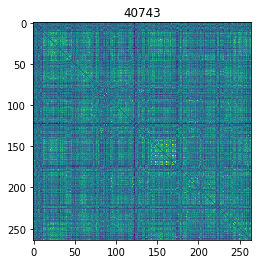

k = 28 


40750
(264, 264)
i = 79


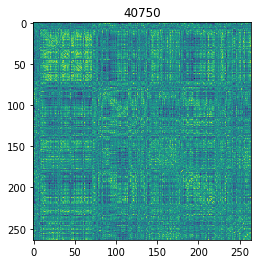

k = 29 


40778
(264, 264)
i = 80


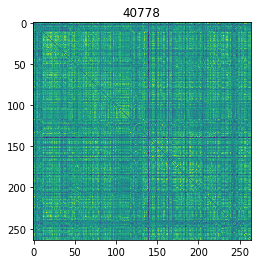

k = 30 


40796
(264, 264)
i = 81


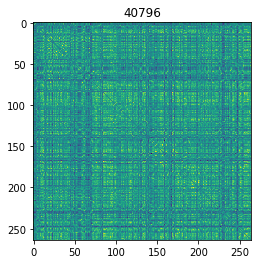

k = 31 


40803
(264, 264)
i = 82


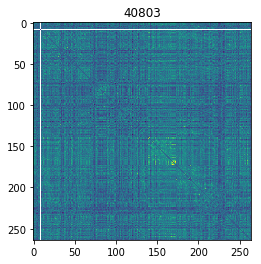

k = 32 


40855
(264, 264)
i = 83


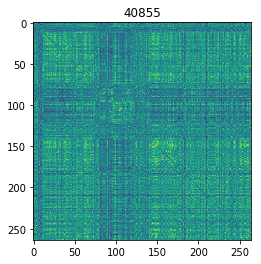

k = 33 


40861
(264, 264)
i = 84


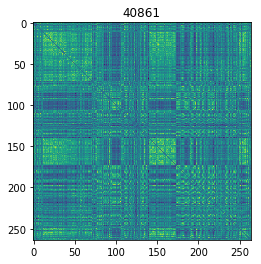

k = 34 


40961
(264, 264)
i = 85


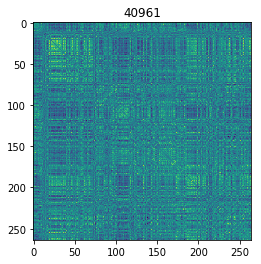

k = 35 


40968
(264, 264)
i = 86


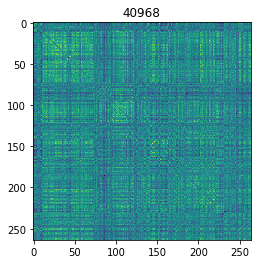

k = 36 




In [383]:
x = {}
fc_subs = []

for trial_type in trial_types:
    print('\n' + trial_type)
    corfiles = glob.glob(nibs_dir + '/sub-*/func/sub-*_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-%s_correlation.tsv' % trial_type)
    corfiles_ya = glob.glob(nibs_dir + '/sub-3*/func/sub-3*_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-%s_correlation.tsv' % trial_type)
    corfiles_oa = glob.glob(nibs_dir + '/sub-4*/func/sub-4*_task-MemMatch_run-concat_space-MNI152NLin2009cAsym_desc-%s_correlation.tsv' % trial_type)
    
    x[trial_type] = np.zeros((264,264, len(corfiles)))
    x[trial_type + '_ya'] = np.zeros((264,264, len(corfiles_ya)))
    x[trial_type + '_oa'] = np.zeros((264,264, len(corfiles_oa)))
    i = 0
    j = 0
    k = 0
    
    for file in sorted(corfiles):
        subject = file.split('sub-')[1][0:5]
        print(subject)
        
        if subject != '30476':
            print(np.vstack(np.array(pd.read_csv(file, sep='\t', na_values="n/a", index_col=0))).shape)
            print('i = %.f' % i)
            x[trial_type][:,:,i] = np.vstack(np.array(pd.read_csv(file, sep='\t', na_values="n/a", index_col=0)))
            np.fill_diagonal(x[trial_type][:,:,i], 0, wrap=False)
            plt.imshow(x[trial_type][:,:,i])
            plt.title(subject)
            plt.show()
            
            fc_subs.append(str(subject))

            if int(subject) < 40000:
                x[trial_type + '_ya'][:,:,j] = np.vstack(np.array(pd.read_csv(file, sep='\t', na_values="n/a", index_col=0)))
                np.fill_diagonal(x[trial_type + '_ya'][:,:,j], 0, wrap=False)
                print('j = %.f \n\n' % j)
                j+=1
            else:
                x[trial_type + '_oa'][:,:,k] = np.vstack(np.array(pd.read_csv(file, sep='\t', na_values="n/a", index_col=0)))    
                np.fill_diagonal(x[trial_type + '_oa'][:,:,k], 0, wrap=False)
                print('k = %.f \n\n' % k)
                k+=1

            i+=1

np.savetxt('/Volumes/psybrain/ADM/derivatives/nibs/fcsubs.txt', fc_subs, fmt='%s')
np.save('/Volumes/psybrain/ADM/derivatives/nibs/memmatch_fc.npy', x)
savemat('/Volumes/psybrain/ADM/derivatives/nibs/memmatch_fc.mat', x)

In [382]:
x['cue_ya'].shape

(264, 264, 51)

In [381]:
x['cue_oa'].shape

(264, 264, 37)

In [109]:
savemat('/Volumes/schnyer/Megan/adm_mem-fc/analysis/nbs/dsnmat_ya_oa.mat', {'dsn_ya_oa': np.hstack((np.vstack((np.ones((51,1)), np.zeros((37,1)))), np.vstack((np.zeros((51,1)), np.ones((37,1))))))})

Remove 30476

In [93]:
savemat('/Volumes/schnyer/Megan/adm_mem-fc/analysis/nbs/memmatch_fc_dmn-fpn.mat', {'fc_dmnfpn': x['cue'][dmn_fpn][:,dmn_fpn]})
savemat('/Volumes/schnyer/Megan/adm_mem-fc/analysis/nbs/memmatch_fc_dmn.mat', {'fc_dmn': x['cue'][dmn][:,dmn]})
savemat('/Volumes/schnyer/Megan/adm_mem-fc/analysis/nbs/memmatch_fc_fpn.mat', {'fc_fpn': x['cue'][fpn][:,fpn]})

In [94]:
np.savetxt('/Volumes/schnyer/Megan/adm_mem-fc/analysis/nbs/coords_fpn.txt', coords[fpn], fmt = '%s')
np.savetxt('/Volumes/schnyer/Megan/adm_mem-fc/analysis/nbs/coords_dmn.txt', coords[dmn], fmt = '%s')
np.savetxt('/Volumes/schnyer/Megan/adm_mem-fc/analysis/nbs/coords_dmn_fpn.txt', coords[dmn_fpn], fmt = '%s')

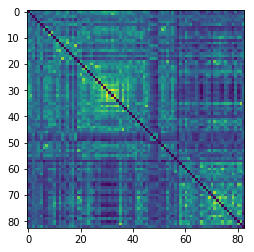

In [62]:
plt.imshow(x['cue'][dmn_fpn][:,dmn_fpn].mean(axis=2))

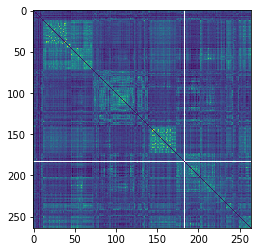

In [63]:
plt.imshow(x['cue_ya'].mean(axis=2))

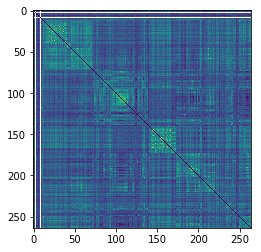

In [64]:
plt.imshow(x['cue_oa'].mean(axis=2))

In [10]:
atlas.loc[fpn].values.flatten()

array(['Fronto-parietal Task Control', 'Fronto-parietal Task Control',
       'Fronto-parietal Task Control', 'Fronto-parietal Task Control',
       'Fronto-parietal Task Control', 'Fronto-parietal Task Control',
       'Fronto-parietal Task Control', 'Fronto-parietal Task Control',
       'Fronto-parietal Task Control', 'Fronto-parietal Task Control',
       'Fronto-parietal Task Control', 'Fronto-parietal Task Control',
       'Fronto-parietal Task Control', 'Fronto-parietal Task Control',
       'Fronto-parietal Task Control', 'Fronto-parietal Task Control',
       'Fronto-parietal Task Control', 'Fronto-parietal Task Control',
       'Fronto-parietal Task Control', 'Fronto-parietal Task Control',
       'Fronto-parietal Task Control', 'Fronto-parietal Task Control',
       'Fronto-parietal Task Control', 'Fronto-parietal Task Control',
       'Fronto-parietal Task Control'], dtype=object)

In [774]:
pd.DataFrame(np.hstack((coords[dmn_fpn], atlas.loc[dmn_fpn].values))).values.tolist()

[[6, 67, -4, 'Default mode'],
 [8, 48, -15, 'Default mode'],
 [-13, -40, 1, 'Default mode'],
 [-18, 63, -9, 'Default mode'],
 [-46, -61, 21, 'Default mode'],
 [43, -72, 28, 'Default mode'],
 [-44, 12, -34, 'Default mode'],
 [46, 16, -30, 'Default mode'],
 [-68, -23, -16, 'Default mode'],
 [-58, -26, -15, 'Default mode'],
 [-39, -75, 44, 'Default mode'],
 [-7, -55, 27, 'Default mode'],
 [6, -59, 35, 'Default mode'],
 [-11, -56, 16, 'Default mode'],
 [-3, -49, 13, 'Default mode'],
 [8, -48, 31, 'Default mode'],
 [15, -63, 26, 'Default mode'],
 [-2, -37, 44, 'Default mode'],
 [11, -54, 17, 'Default mode'],
 [52, -59, 36, 'Default mode'],
 [23, 33, 48, 'Default mode'],
 [-10, 39, 52, 'Default mode'],
 [-16, 29, 53, 'Default mode'],
 [-35, 20, 51, 'Default mode'],
 [22, 39, 39, 'Default mode'],
 [13, 55, 38, 'Default mode'],
 [-10, 55, 39, 'Default mode'],
 [-20, 45, 39, 'Default mode'],
 [6, 54, 16, 'Default mode'],
 [6, 64, 22, 'Default mode'],
 [-7, 51, -1, 'Default mode'],
 [9, 54, 3, '

## Age group differences in DMN-FPN FC during cue <a id='age-group-dif-mean-fc'></a>

In [18]:
x = np.load('/Volumes/psybrain/ADM/derivatives/nibs/memmatch_fc.npy', allow_pickle=True).flat[0]
fc_subs = np.loadtxt('/Volumes/psybrain/ADM/derivatives/nibs/fcsubs.txt')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in greater
  This is separate from the ipykernel package so we can avoid doing imports until


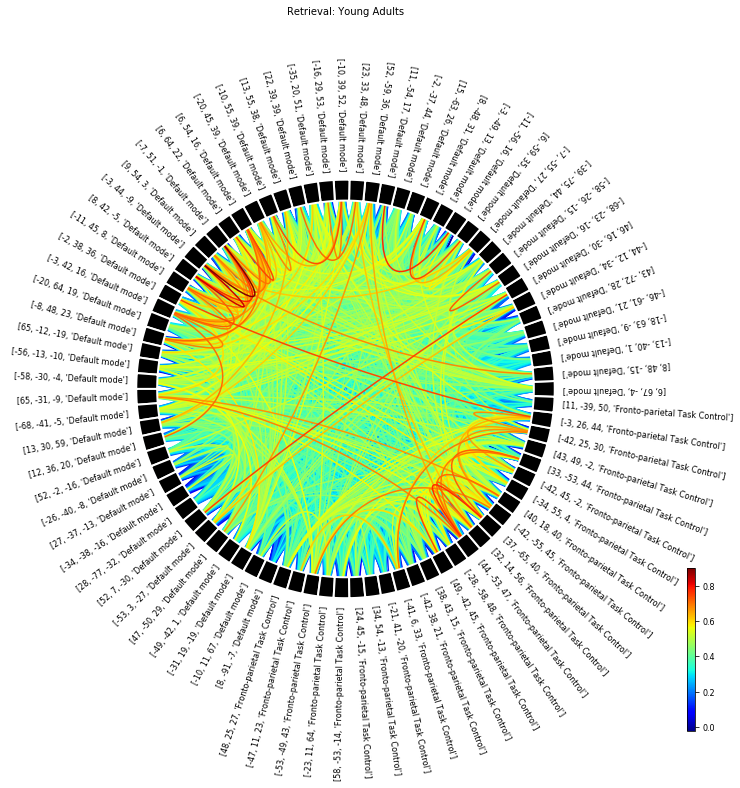

In [468]:
xpy = x['cue_ya'].mean(axis=2)

n_lines = int(np.sum((xpy > 0) / 2))
fig = plt.figure(figsize=(15, 15))
node_labels = pd.DataFrame(np.hstack((coords[dmn_fpn], atlas.loc[dmn_fpn].values))).values.tolist()             
plot_connectivity_circle(xpy[dmn_fpn][:,dmn_fpn], node_labels, n_lines=n_lines, fig=fig, title='Retrieval: Young Adults', 
                         fontsize_title=10, facecolor='white', textcolor='black', 
                         colormap='jet', colorbar=1, node_colors=['black'], 
                         node_edgecolor=['white'], show=False, interactive=False)
fig.savefig(results_dir + 'cue_ya_mean_dmn-fpn_fc.png')

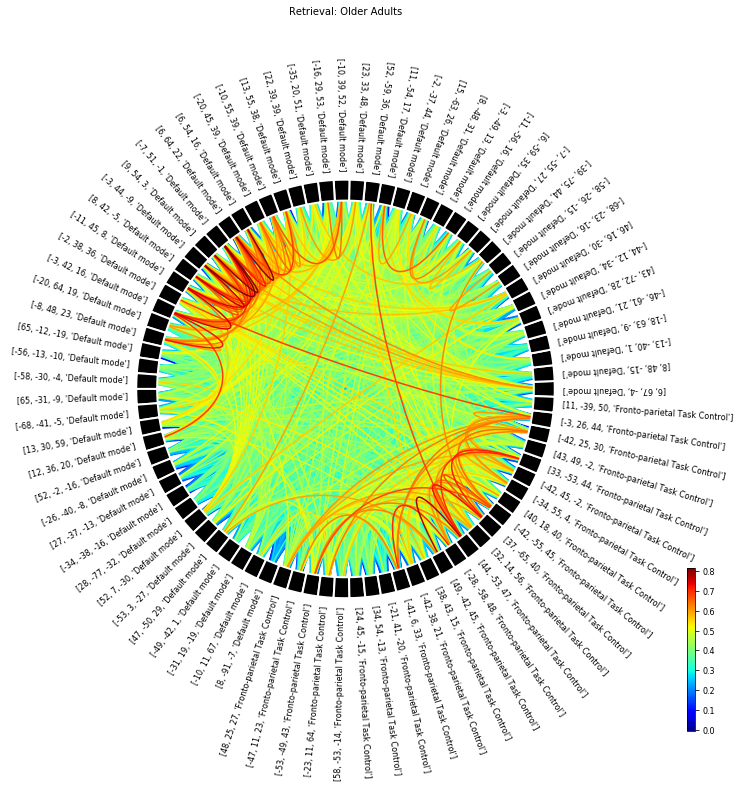

In [469]:
xpo = x['cue_oa'].mean(axis=2)
fig = plt.figure(figsize=(15, 15))

node_labels = pd.DataFrame(np.hstack((coords[dmn_fpn], atlas.loc[dmn_fpn].values))).values.tolist()
plot_connectivity_circle(xpo[dmn_fpn][:,dmn_fpn], node_labels, n_lines=n_lines, fig=fig, title='Retrieval: Older Adults', 
                         fontsize_title=10, facecolor='white', textcolor='black', 
                         colormap='jet', colorbar=1, node_colors=['black'], 
                         node_edgecolor=['white'], show=False, interactive=False)

fig.savefig(results_dir + 'cue_oa_mean_dmn-fpn_fc.png')


In [39]:
x['cue_ya'].shape

(264, 264, 51)

In [40]:
x['cue_oa'].shape

(264, 264, 37)

In [43]:
x['cue_oa'][:,:,35]

array([[0.        , 0.63977629, 0.01653341, ..., 0.34015785, 0.03554068,
        0.21508494],
       [0.63977629, 0.        , 0.30250593, ..., 0.67654755, 0.31423401,
        0.39361927],
       [0.01653341, 0.30250593, 0.        , ..., 0.35144185, 0.09509778,
        0.32740648],
       ...,
       [0.34015785, 0.67654755, 0.35144185, ..., 0.        , 0.53777688,
        0.36343411],
       [0.03554068, 0.31423401, 0.09509778, ..., 0.53777688, 0.        ,
        0.19420943],
       [0.21508494, 0.39361927, 0.32740648, ..., 0.36343411, 0.19420943,
        0.        ]])

In [44]:
x['cue_ya'][fpn][:,fpn,:].shape

(25, 25, 51)